# PART- 2 ( Handling With Missing Values )

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats.mstats import winsorize

%matplotlib inline

pd.set_option('display.max_columns', 750)
pd.set_option('display.max_rows', 750)
pd.set_option('display.min_rows', 750)

In [2]:
df = pd.read_csv("final_scout_cln_with_nulls.csv")
df_0 = df.copy()

In [3]:
df.head(4).T

,0,1,2,3
make,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz,Mercedes-Benz
location,ES,ES,ES,ES
price,16950.0,80900.0,69900.0,46990.0
body_type,Compact,Compact,Compact,Compact
type,Used,Pre-registered,Used,Used
doors,5.0,4.0,5.0,5.0
warranty,24.0,24.0,12.0,12.0
mileage,120200.0,5000.0,18900.0,18995.0
gearbox,Manual,Automatic,Automatic,Automatic
fuel_type,diesel,electric,benzine,benzine


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24552 entries, 0 to 24551
Data columns (total 35 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   make                  24552 non-null  object 
 1   location              24552 non-null  object 
 2   price                 24552 non-null  float64
 3   body_type             24552 non-null  object 
 4   type                  24552 non-null  object 
 5   doors                 24213 non-null  float64
 6   warranty              10524 non-null  float64
 7   mileage               24551 non-null  float64
 8   gearbox               24318 non-null  object 
 9   fuel_type             22980 non-null  object 
 10  colour                23117 non-null  object 
 11  paint                 13261 non-null  object 
 12  seller                24552 non-null  object 
 13  seats                 22043 non-null  float64
 14  power                 23995 non-null  float64
 15  engine_size        

In [5]:
df.shape

(24552, 35)

In [6]:
null_sum = pd.DataFrame(df.isna().sum(), columns = ["null_sum"])
# null_sum
null_perc = round(pd.DataFrame(df.isna().sum()/df.shape[0]*100 , columns = ["null_perc"]),3)
# null_perc 

null_summary = pd.concat([null_sum,null_perc], axis= 1).reset_index().rename(columns = {"index":"col_names"})
null_summary

,col_names,null_sum,null_perc
0,make,0,0.000
1,location,0,0.000
2,price,0,0.000
3,body_type,0,0.000
4,type,0,0.000
5,doors,339,1.381
6,warranty,14028,57.136
7,mileage,1,0.004
8,gearbox,234,0.953
9,fuel_type,1572,6.403


In [7]:
# Let's remember our User Defined Function for first looking to the columns
# copied from chat 

def first_looking(col):
    print("column name    : ", col)  # Prints out related column name
    print("--------------------------------")
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()*100 / df.shape[0], 2))  # Calculates the percentage of Null values for related column
    print("num_of_nulls   : ", df[col].isnull().sum())  # Prints out the total number of Null values for related column
    print("num_of_uniques : ", df[col].astype(str).nunique())  # Prints out the number of unique values for related column
    print("--------------------------------")
    print(df[col].value_counts(dropna = False))  # Prints out the number of occurance for unique values in the related column

In [8]:
# quick percent view 
def show_null_perc(Serial):
    perc = round(Serial.isna().sum()/Serial.shape[0]*100,2)
    return perc

## Fill nulls 1-by-1
Start from features with least null number

In [9]:
# check coloumns with missing 

col_with_miss = []

for i in df.columns:
    if df[i].isna().sum() != 0:
        if i not in col_with_miss:
            col_with_miss.append(i)

print(col_with_miss)

['doors', 'warranty', 'mileage', 'gearbox', 'fuel_type', 'colour', 'paint', 'seats', 'power', 'engine_size', 'gears', 'co_emissions', 'drivetrain', 'cylinders', 'comfort_convenience', 'entertainment_media', 'safety_security', 'extras', 'empty_weight', 'full_service_history', 'emission_class', 'upholstery_colour', 'upholstery', 'production_date', 'previous_owner', 'age', 'fuel_comb_cons', 'fuel_city_cons', 'fuel_country_cons']


In [10]:
len(col_with_miss)

29

### mileage	

In [11]:
first_looking("mileage")

column name    :  mileage
--------------------------------
per_of_nulls   :  % 0.0
num_of_nulls   :  1
num_of_uniques :  14184
--------------------------------
10.0        532
1.0         163
5000.0      116
100.0       112
5.0         105
20.0         97
15.0         81
100000.0     75
3000.0       73
50.0         71
90000.0      66
8000.0       65
6000.0       62
10000.0      58
60000.0      57
160000.0     56
15000.0      55
150000.0     55
140000.0     55
80000.0      53
1500.0       52
130000.0     50
110000.0     49
2.0          48
120000.0     47
9900.0       47
65000.0      47
75000.0      46
85000.0      46
1000.0       46
200000.0     44
170000.0     43
125000.0     43
50000.0      43
89000.0      42
55000.0      42
70000.0      42
2500.0       41
9500.0       41
25000.0      40
500.0        40
99000.0      39
4500.0       39
30000.0      39
20000.0      38
45000.0      37
35000.0      37
9000.0       37
3500.0       37
190000.0     37
12.0         36
2000.0       36
150.0   

Only 1 missing value fill it by mean milage according to age

In [12]:
df[df['mileage'].isnull()].index.tolist()

[10195]

In [13]:
df.iloc[[10195]]

,make,location,price,body_type,type,doors,warranty,mileage,gearbox,fuel_type,colour,paint,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,comfort_convenience,entertainment_media,safety_security,extras,empty_weight,full_service_history,emission_class,upholstery_colour,upholstery,production_date,previous_owner,age,fuel_comb_cons,fuel_city_cons,fuel_country_cons
10195,Fiat,NL,41570.0,Off-Road/Pick-up,Demonstration,5.0,NaN,NaN,Automatic,NaN,Blue,Metallic,Dealer,5.0,96.0,1469.0,7.0,NaN,NaN,4.0,"Air conditioning, Armrest, Automatic climate c...","Android Auto, Apple CarPlay, Radio","ABS, Central door lock, Central door lock with...","Alloy wheels, Electronic parking brake, Emerge...",1380.0,NaN,NaN,Beige,Full leather,2022.0,NaN,0.0,NaN,NaN,NaN


In [14]:
# df["mileage"].fillna(df.groupby("age").mileage.transform("mean"), inplace=True)

In [15]:
df["mileage"].fillna(0, inplace=True) # since age is zero

In [16]:
df["mileage"].isna().sum()

0

### age

In [17]:
show_null_perc(df.age)

0.01

In [18]:
df.age.isna().sum()

2

In [19]:
df.age.value_counts(dropna=False)

 3.0      3108
 0.0      2806
 4.0      2753
 1.0      2596
 2.0      2170
 5.0      2004
 6.0      1255
 7.0       954
 8.0       758
 9.0       626
 10.0      593
 11.0      572
 12.0      486
 15.0      389
 13.0      373
 14.0      369
 16.0      354
 17.0      273
 18.0      219
 19.0      177
 20.0      162
 21.0      158
 22.0      132
 23.0      124
 24.0       82
 28.0       79
 25.0       78
 27.0       75
 26.0       70
 30.0       58
 31.0       56
 29.0       52
 32.0       50
 56.0       38
 55.0       32
 34.0       30
 57.0       29
 49.0       28
 54.0       25
 35.0       25
 50.0       24
 36.0       22
 44.0       20
 33.0       19
 37.0       18
 51.0       18
 52.0       17
 39.0       16
 53.0       16
 43.0       14
 47.0       13
 46.0       11
 45.0       11
 38.0       10
 40.0       10
 48.0        9
 59.0        9
 58.0        9
 41.0        8
 60.0        6
 42.0        5
 61.0        5
 67.0        5
 65.0        4
 64.0        4
 62.0        3
 90.0     

In [20]:
#df.groupby(["mileage"])['age'].describe()

In [21]:
df[df['age'].isnull()].index.tolist()
#type(df["age"][661])

[661, 15492]

In [22]:
# check the coloumn
df.iloc[[661, 15492]]

,make,location,price,body_type,type,doors,warranty,mileage,gearbox,fuel_type,colour,paint,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,comfort_convenience,entertainment_media,safety_security,extras,empty_weight,full_service_history,emission_class,upholstery_colour,upholstery,production_date,previous_owner,age,fuel_comb_cons,fuel_city_cons,fuel_country_cons
661,Mercedes-Benz,BE,108900.0,Convertible,Demonstration,2.0,24.0,3856.0,Automatic,benzine,Green,Metallic,Dealer,4.0,320.0,2999.0,8.0,219.0,4WD,NaN,"360° camera, Air conditioning, Automatic clima...","Android Auto, Apple CarPlay, Bluetooth, CD pla...","Alarm system, Central door lock, Driver-side a...","Alloy wheels, Ambient lighting, Automatically ...",NaN,NaN,Euro 6,Other,Full leather,NaN,NaN,NaN,NaN,NaN,NaN
15492,Toyota,NL,33999.0,Compact,Demonstration,5.0,NaN,2494.0,Automatic,benzine,Grey,Metallic,Dealer,NaN,135.0,1987.0,NaN,89.0,NaN,4.0,"Air conditioning, Armrest, Automatic climate c...","Android Auto, Apple CarPlay, Bluetooth, Digita...","ABS, Daytime running lights, Distance warning ...","Alloy wheels, Automatically dimming interior m...",1315.0,Yes,Euro 1,NaN,Cloth,2021.0,NaN,NaN,NaN,NaN,NaN


In [23]:
# df["mileage"].fillna(df.groupby("age").age.transform(stats.mode), inplace=False)
# test = pd.Series([2,3])
# test.mode()[0]

In [24]:
df.groupby("mileage").age.agg(lambda x: x.mode())

mileage
0.0                                                0.0
1.0                                                0.0
2.0                                                0.0
3.0                                                0.0
4.0                                                0.0
5.0                                                0.0
6.0                                                0.0
7.0                                                0.0
8.0                                                0.0
9.0                                                0.0
10.0                                               0.0
11.0                                               0.0
12.0                                               0.0
13.0                                               0.0
14.0                                               0.0
15.0                                               0.0
16.0                                               0.0
17.0                                               0.0
18

Only two missing value, fill it by grouping accordign to mileage and choosing most common one (mode)-  here most common age is 1 for these mileages

In [25]:
df["age"].fillna(1, inplace=True) 

In [26]:
df["age"].isnull().sum()

0

### Create some functions to handle missing values

#### Single-double-triple stage grouping
Rick gave some idea and pieces of codes

In [27]:
def fill_bymode_single(df, group_col, col_name):
    for group in list(df[group_col].unique()):
        cond = df[group_col]==group
        mode = list(df[cond][col_name].mode())
        if mode != []:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[cond][col_name].mode()[0])
        else:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[col_name].mode()[0])

In [28]:
def fill_bymode_double(df, group_col1, group_col2, col_name):
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            cond1 = df[group_col1]==group1
            cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
            mode1 = list(df[cond1][col_name].mode())
            mode2 = list(df[cond2][col_name].mode())
            if mode2 != []:
                df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[cond2][col_name].mode()[0])
            elif mode1 != []:
                df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[cond1][col_name].mode()[0])
            else:
                df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[col_name].mode()[0])

In [29]:
def fill_bymode_triple(df, group_col1, group_col2, group_col3, col_name):
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            for group3 in list(df[group_col3].unique()):
                cond1 = df[group_col1]==group1
                cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
                cond3 = (df[group_col1]==group1) & (df[group_col2]==group2) & (df[group_col3]==group3)
                mode1 = list(df[cond1][col_name].mode())
                mode2 = list(df[cond2][col_name].mode())
                mode3 = list(df[cond3][col_name].mode())
                if mode3 != []:
                    df.loc[cond3, col_name] = df.loc[cond3, col_name].fillna(df[cond3][col_name].mode()[0])
                elif mode2 != []:
                    df.loc[cond3, col_name] = df.loc[cond3, col_name].fillna(df[cond2][col_name].mode()[0])
                elif mode1 != []:
                    df.loc[cond3, col_name] = df.loc[cond3, col_name].fillna(df[cond1][col_name].mode()[0])
                else:
                    df.loc[cond3, col_name] = df.loc[cond3, col_name].fillna(df[col_name].mode()[0])

### doors	

In [30]:
first_looking("doors")

column name    :  doors
--------------------------------
per_of_nulls   :  % 1.38
num_of_nulls   :  339
num_of_uniques :  7
--------------------------------
5.0    14605
2.0     4734
4.0     2752
3.0     2115
NaN      339
6.0        5
1.0        2
Name: doors, dtype: int64


In [31]:
df.doors.replace(np.nan, "n_n", inplace=True)

In [32]:
df.doors.value_counts(dropna=False)

5.0    14605
2.0     4734
4.0     2752
3.0     2115
n_n      339
6.0        5
1.0        2
Name: doors, dtype: int64

In [33]:
df.groupby(["make","body_type","doors"]).price.describe()

count           mean            std  \
make          body_type          doors                                        
Dacia          Compact           4.0     20.0   11223.700000    4309.455199   
                                 5.0    222.0   13048.328829    4828.701385   
                                 n_n      1.0   12990.000000            NaN   
               Convertible       n_n      2.0   14900.000000    2828.427125   
               Coupe             5.0      2.0   11400.000000    2121.320344   
               Off-Road/Pick-up  2.0      1.0   15490.000000            NaN   
                                 4.0     21.0   16983.523810    5560.325293   
                                 5.0    317.0   16857.451104    4235.361705   
                                 n_n      1.0   16700.000000            NaN   
               Sedan             4.0     33.0    9580.515152    5115.933878   
                                 5.0    230.0   12429.178261    4170.342107   
                                 n_n      3.0   15443.333333    7786.015241   
               Station wagon     4.0     68.0   11209.588235    5967.153241   
                                 5.0    200.0   13059.100000    5630.537079   
                                 6.0      5.0    6050.000000    6268.572405   
                                 n_n      2.0   10117.500000    4550.232137   
Fiat           Compact           2.0     22.0   14797.454545    6387.768011   
                                 3.0    245.0   14377.881633    7463.857607   
                                 4.0     10.0   18087.500000   12292.554696   
                                 5.0     95.0   10186.610526    4741.940222   
                                 n_n     10.0   10870.000000    6474.780134   
               Convertible       1.0      1.0   19000.000000            NaN   
                                 2.0    236.0   17940.427966    7502.285212   
                                 3.0     58.0   18717.500000    6278.500774   
                                 4.0      1.0  159000.000000            NaN   
                                 5.0      3.0   32363.333333     755.005519   
                                 n_n      2.0   31710.000000   23659.792899   
               Coupe             2.0    243.0   15362.061728   19548.107216   
                                 3.0     77.0   14527.740260   12568.495798   
                                 4.0      1.0   17990.000000            NaN   
                                 5.0      5.0   11850.000000    4008.116765   
                                 n_n     30.0   25973.633333   29519.807520   
               Off-Road/Pick-up  2.0      3.0   19100.000000    8057.294831   
                                 4.0     17.0   22662.823529    5115.331163   
                                 5.0    303.0   18607.221122    5002.135241   
                                 n_n      3.0   16663.333333    4409.085317   
               Sedan             2.0      8.0   13139.875000    7992.720625   
                                 3.0    120.0   16171.233333    8309.626762   
                                 4.0     43.0   14050.418605    6283.696581   
                                 5.0    171.0   14735.263158    6354.675864   
                                 n_n      1.0   23500.000000            NaN   
               Station wagon     2.0      1.0   12890.000000            NaN   
                                 3.0      4.0   10421.250000    4864.987795   
                                 4.0     23.0   19936.521739    6213.682563   
                                 5.0    239.0   15261.866109    6183.210778   
                                 n_n      1.0   24490.000000            NaN   
Ford           Compact           1.0      1.0   11790.000000            NaN   
                                 2.0      9.0    7214.111111    3655.190332   
                                 3.0     87.0   10774.229885    6630.804200   
           

In [34]:
df.doors.replace("n_n",np.nan,inplace=True)

In [35]:
# check by agg
#df.groupby(["make","body_type"]).doors.agg(lambda x: x.mode()[0] if len(x.mode())>0 else df["doors"].mode()[0])

Group by "make","body_type" and fill by mode of number of doors. 

In [36]:
#group by corret but x.mode()[0] zero not very useful (only fill most outer)- use a function 
#df.doors.fillna(df.groupby(["make","body_type"]).doors.transform(lambda x: x.mode()[0] if len(x.mode())>0 else df["doors"].mode()[0]),inplace = True)

In [37]:
fill_bymode_double(df, "make","body_type", "doors")

In [38]:
df.doors.value_counts(dropna=False)

5.0    14732
2.0     4919
4.0     2769
3.0     2125
6.0        5
1.0        2
Name: doors, dtype: int64

In [39]:
df["doors"].unique()

array([5., 4., 3., 2., 1., 6.])

In [40]:
df["doors"].isna().sum()

0

### gearbox

In [41]:
first_looking("gearbox")

column name    :  gearbox
--------------------------------
per_of_nulls   :  % 0.95
num_of_nulls   :  234
num_of_uniques :  4
--------------------------------
Manual            14567
Automatic          9688
NaN                 234
Semi-automatic       63
Name: gearbox, dtype: int64


In [42]:
df.gearbox.fillna("n_n",inplace=True)

In [43]:
df.gearbox.value_counts(dropna=False)

Manual            14567
Automatic          9688
n_n                 234
Semi-automatic       63
Name: gearbox, dtype: int64

In [44]:
df.groupby(["make","body_type","gearbox"]).price.describe()

count           mean  \
make          body_type          gearbox                                
Dacia          Compact           Automatic        44.0   20030.113636   
                                 Manual          199.0   11320.944724   
               Convertible       n_n               2.0   14900.000000   
               Coupe             Manual            2.0   11400.000000   
               Off-Road/Pick-up  Automatic        53.0   18551.188679   
                                 Manual          286.0   16541.793706   
                                 n_n               1.0   18490.000000   
               Sedan             Automatic        26.0   16758.538462   
                                 Manual          240.0   11606.150000   
               Station wagon     Automatic         9.0   10588.777778   
                                 Manual          263.0   12490.771863   
                                 Semi-automatic    1.0    8000.000000   
                                 n_n               2.0   18092.500000   
Fiat           Compact           Automatic        58.0   22195.689655   
                                 Manual          319.0   11758.163009   
                                 Semi-automatic    1.0   15795.000000   
                                 n_n               4.0   12857.250000   
               Convertible       Automatic        62.0   25376.741935   
                                 Manual          238.0   17082.806723   
                                 n_n               1.0   19000.000000   
               Coupe             Automatic        12.0   24926.750000   
                                 Manual          323.0   14559.520124   
                                 n_n              21.0   33629.523810   
               Off-Road/Pick-up  Automatic        75.0   22272.373333   
                                 Manual          244.0   17763.213115   
                                 Semi-automatic    1.0    9900.000000   
                                 n_n               6.0   19332.333333   
               Sedan             Automatic        47.0   24385.255319   
                                 Manual          294.0   13635.234694   
                                 Semi-automatic    1.0   11700.000000   
                                 n_n               1.0   26499.000000   
               Station wagon     Automatic        25.0   21087.080000   
                                 Manual          237.0   14667.839662   
                                 Semi-automatic    1.0   28000.000000   
                                 n_n               5.0   30747.200000   
Ford           Compact           Automatic        34.0   20470.441176   
                                 Manual          332.0   14219.891566   
                                 n_n               2.0   14644.500000   
               Convertible       Automatic       245.0   39970.983673   
                                 Manual          124.0   31785.250000   
                                 Semi-automatic    1.0   39000.000000   
                                 n_n              11.0   26253.272727   
               Coupe             Automatic       190.0   69689.257895   
                                 Manual          162.0   58693.574074   
                                 Semi-automatic    3.0   41633.333333   
                                 n_n               3.0   37313.333333   
               Off-Road/Pick-up  Automatic       181.0   42749.453039   
                                 Manual          196.0   24341.454082   
                                 Semi-automatic    1.0   38750.000000   
                                 n_n               1.0   25470.000000   
               Sedan             Automatic        66.0   24049.075758   
                                 Manual          315.0   19386.600000   
                                 Semi-automatic    1.0   64400.000000   
                                 n

In [45]:
df.gearbox.replace("n_n", np.nan, inplace=True)

In [46]:
#again not going in to layers if x.mode()[0] empty- use fuction
#df.gearbox.fillna(df.groupby(["make","body_type"]).gearbox.transform(lambda x: x.mode()[0] if len(x.mode())>0 else df.gearbox.mode()[0]),inplace=True)

In [47]:
fill_bymode_double(df, "make", "body_type", "gearbox")

In [48]:
df.gearbox.unique()

array(['Manual', 'Automatic', 'Semi-automatic'], dtype=object)

In [49]:
df.gearbox.value_counts(dropna=False)

Manual            14740
Automatic          9749
Semi-automatic       63
Name: gearbox, dtype: int64

### gears

In [50]:
first_looking("gears")

column name    :  gears
--------------------------------
per_of_nulls   :  % 34.31
num_of_nulls   :  8424
num_of_uniques :  12
--------------------------------
NaN     8424
6.0     7050
5.0     4565
7.0     1634
8.0     1262
1.0      628
9.0      609
4.0      233
10.0      95
0.0       28
3.0       22
2.0        2
Name: gears, dtype: int64


In [51]:
df.gears.fillna("n_n", inplace=True)

In [52]:
df.gears.value_counts()

n_n     8424
6.0     7050
5.0     4565
7.0     1634
8.0     1262
1.0      628
9.0      609
4.0      233
10.0      95
0.0       28
3.0       22
2.0        2
Name: gears, dtype: int64

In [53]:
df.groupby(["make","body_type","gearbox","gears"]).price.describe()

count           mean  \
make          body_type          gearbox        gears                         
Dacia          Compact           Automatic      1.0     28.0   22413.392857   
                                                5.0      4.0   11952.500000   
                                                6.0      4.0   15332.250000   
                                                n_n      8.0   18076.375000   
                                 Manual         5.0    162.0   10755.598765   
                                                6.0     21.0   15622.095238   
                                                n_n     16.0   11399.812500   
               Convertible       Manual         n_n      2.0   14900.000000   
               Coupe             Manual         n_n      2.0   11400.000000   
               Off-Road/Pick-up  Automatic      5.0      1.0    7000.000000   
                                                6.0      6.0   18247.000000   
                                                n_n     46.0   18841.978261   
                                 Manual         5.0     38.0   14274.947368   
                                                6.0    135.0   17228.822222   
                                                n_n    114.0   16500.912281   
               Sedan             Automatic      1.0      5.0   18817.800000   
                                                5.0      2.0    9990.000000   
                                                6.0      1.0    8900.000000   
                                                n_n     18.0   17375.166667   
                                 Manual         4.0      1.0    9999.000000   
                                                5.0     80.0    9572.350000   
                                                6.0     16.0   17455.500000   
                                                n_n    143.0   12100.706294   
               Station wagon     Automatic      5.0      2.0    8745.000000   
                                                6.0      1.0    6900.000000   
                                                n_n      6.0   11818.166667   
                                 Manual         5.0     94.0    9882.489362   
                                                6.0     33.0   16885.272727   
                                                n_n    138.0   13297.753623   
                                 Semi-automatic 6.0      1.0    8000.000000   
Fiat           Compact           Automatic      0.0      1.0   27765.000000   
                                                1.0     18.0   31415.277778   
                                                4.0      1.0    1999.000000   
                                                5.0     16.0   17030.875000   
                                                6.0      3.0   20962.333333   
                                                n_n     19.0   18775.263158   
                                 Manual         2.0      1.0   10950.000000   
                                                4.0      4.0    9612.500000   
                                                5.0    165.0   10600.684848   
                                                6.0     91.0   14843.670330   
                                                n_n     62.0   10532.193548   
                                 Semi-automatic 5.0      1.0   15795.000000   
               Convertible       Automatic      1.0     18.0   33607.500000   
                                                5.0     13.0   15981.615385   
                                                6.0      9.0   24470.000000   
                                                n_n     22.0   24565.090909   
                                 Manual         4.0      1.0   15000.000000   
                                                5.0     91.0   12816.791209   
                                                6.0     90.0   20802.033333   
                          

In [54]:
df.gears.replace("n_n", np.nan, inplace=True)

In [55]:
df.gears.value_counts(dropna=False)

NaN     8424
6.0     7050
5.0     4565
7.0     1634
8.0     1262
1.0      628
9.0      609
4.0      233
10.0      95
0.0       28
3.0       22
2.0        2
Name: gears, dtype: int64

In [56]:
# not go to deepest layer if x.mode()[0] empty, use user defined function
#df.gears.fillna(df.groupby(["make","body_type","gearbox"]).gears.transform(lambda x: x.mode()[0] if len(x.mode())>0 else df.gears.mode()[0]),inplace=False)

In [57]:
#write a function to solve this looping issues to add layers
# df.gears.fillna(df.groupby(["make","body_type","gearbox"]).gears.transform(lambda x: x.mode()[0] if len(x.mode())>0
#                                                                     else 
#                                                                     df.groupby(["make","body_type"]).gears.transform(lambda x: x.mode()[0]) 
#                                                                     if len(x.mode())>0 else
#                                                                     df.groupby(["make"]).gears.transform(lambda x: x.mode()[0]) 
#                                                                     if len(x.mode())>0 else
#                                                                     df.gears.mode()[0]
#                                                                           ),inplace=False)

In [58]:
# code shared by Rick
# for group in list(df["make_model"].unique()):
#     cond = df["make_model"]==group
#     mode = list(df[cond]["body_type"].mode())
#     if mode != []:
#         df.loc[cond, "body_type"] = df.loc [cond, "body_type"].fillna(df[cond]["body_type"].mode()[0])
#     else:
            
#         df.loc[cond, "body_type"] = df.loc[cond, "body_type"].fillna(df["body_type"].mode()[0])

In [59]:
fill_bymode_triple(df,"make","body_type","gearbox","gears")

In [60]:
df["gears"].value_counts(dropna=False)

6.0     10442
5.0      6446
7.0      2395
8.0      2109
9.0      1421
1.0      1195
4.0       274
10.0      216
0.0        28
3.0        24
2.0         2
Name: gears, dtype: int64

In [61]:
df["gears"].unique()

array([ 6.,  9.,  8.,  7.,  1.,  5.,  4.,  3.,  0.,  2., 10.])

In [62]:
df["gears"].isna().sum()

0

<Axes: xlabel='gears', ylabel='price'>

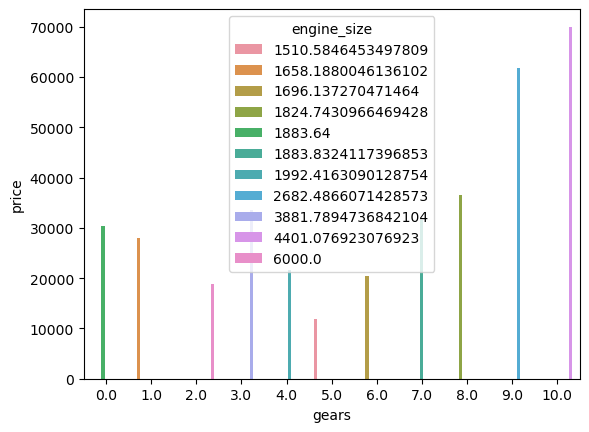

In [63]:
sns.barplot(x=df.groupby("gears")["price"].mean().index,y=df.groupby("gears")["price"].mean(),hue=df.groupby("gears")["engine_size"].mean())

### production_date	

In [64]:
df.production_date.value_counts(dropna=False)

NaN       19105
2019.0     1071
2021.0      906
2022.0      802
2020.0      708
2018.0      701
2017.0      368
2016.0      230
2015.0      114
2014.0       89
2013.0       73
2010.0       48
2012.0       41
2011.0       41
2008.0       24
2009.0       24
2007.0       17
2006.0       15
2002.0       14
2004.0       13
2003.0       13
1967.0       12
2001.0       12
1966.0       11
2005.0        9
1965.0        9
1999.0        8
1994.0        8
1970.0        8
1997.0        7
1968.0        7
2000.0        7
1998.0        5
1990.0        3
1973.0        3
1987.0        3
1993.0        3
1996.0        3
1995.0        2
1969.0        2
1978.0        2
1982.0        2
1991.0        2
1961.0        1
1954.0        1
1988.0        1
1962.0        1
1981.0        1
1985.0        1
1976.0        1
Name: production_date, dtype: int64

In [65]:
show_null_perc(df.production_date)

77.81

Since age gives the same info drop this

In [66]:
df.drop("production_date", axis=1, inplace=True)

### fuel_type

In [67]:
first_looking("fuel_type")

column name    :  fuel_type
--------------------------------
per_of_nulls   :  % 6.4
num_of_nulls   :  1572
num_of_uniques :  7
--------------------------------
benzine        15331
diesel          6987
NaN             1572
gas              330
electric         176
others           138
gas_benzine       18
Name: fuel_type, dtype: int64


In [68]:
df.fuel_type.fillna("n_n", inplace=True)

In [69]:
df.fuel_type.value_counts(dropna=False)

benzine        15331
diesel          6987
n_n             1572
gas              330
electric         176
others           138
gas_benzine       18
Name: fuel_type, dtype: int64

In [70]:
df.groupby("fuel_type").co_emissions.describe()

,count,mean,std,min,25%,50%,75%,max
fuel_type,,,,,,,,
benzine,11158.0,143.862610,181.648207,0.0,112.0,134.0,169.75,15168.0
diesel,4556.0,126.203468,46.903194,0.0,106.0,123.0,145.00,1410.0
electric,176.0,0.761364,9.949581,0.0,0.0,0.0,0.00,132.0
gas,236.0,121.161017,40.240018,0.0,98.0,117.0,133.50,327.0
gas_benzine,16.0,107.562500,53.561141,0.0,89.0,103.0,132.25,196.0
n_n,810.0,74.943210,42.631363,0.0,39.0,85.0,101.75,201.0
others,51.0,104.254902,41.021381,22.0,92.5,114.0,134.50,156.0


In [71]:
df.fuel_type = ["gas_benzine" if i == "others" else i  for i in df.fuel_type]

In [72]:
df.fuel_type.value_counts(dropna=False)

benzine        15331
diesel          6987
n_n             1572
gas              330
electric         176
gas_benzine      156
Name: fuel_type, dtype: int64

In [73]:
df.groupby("fuel_type").co_emissions.describe()

,count,mean,std,min,25%,50%,75%,max
fuel_type,,,,,,,,
benzine,11158.0,143.862610,181.648207,0.0,112.0,134.0,169.75,15168.0
diesel,4556.0,126.203468,46.903194,0.0,106.0,123.0,145.00,1410.0
electric,176.0,0.761364,9.949581,0.0,0.0,0.0,0.00,132.0
gas,236.0,121.161017,40.240018,0.0,98.0,117.0,133.50,327.0
gas_benzine,67.0,105.044776,43.918462,0.0,89.0,113.0,134.50,196.0
n_n,810.0,74.943210,42.631363,0.0,39.0,85.0,101.75,201.0


In [74]:
cond1 = (df['co_emissions'] < 1)
cond2 = ((df['co_emissions'] >= 1) & (df['co_emissions'] < 106))
cond3 = ((df['co_emissions'] >= 106) & (df['co_emissions'] < 122))
cond4 = ((df['co_emissions'] >= 122) & (df['co_emissions'] < 135))
cond5 = (df['co_emissions'] >= 135)

In [75]:
df.loc[cond1,'fuel_type'] = df.loc[cond1,'fuel_type'].replace('n_n', "electric")
df.loc[cond2,'fuel_type'] = df.loc[cond2,'fuel_type'].replace('n_n', "gas_benzine")
df.loc[cond3,'fuel_type'] = df.loc[cond3,'fuel_type'].replace('n_n', "gas")
df.loc[cond4,'fuel_type'] = df.loc[cond4,'fuel_type'].replace('n_n', "diesel")
df.loc[cond5,'fuel_type'] = df.loc[cond5,'fuel_type'].replace('n_n', "benzine")

In [76]:
df.fuel_type.value_counts(dropna=False)

benzine        15378
diesel          7031
n_n              762
gas_benzine      691
gas              429
electric         261
Name: fuel_type, dtype: int64

In [77]:
df.groupby("fuel_type").age.describe()

,count,mean,std,min,25%,50%,75%,max
fuel_type,,,,,,,,
benzine,15378.0,8.107881,10.552784,-3.0,2.0,4.0,11.0,122.0
diesel,7031.0,5.621818,4.331095,0.0,3.0,4.0,7.0,47.0
electric,261.0,1.831418,2.076038,0.0,0.0,1.0,2.0,13.0
gas,429.0,4.365967,11.454659,-180.0,1.0,2.0,5.0,56.0
gas_benzine,691.0,2.270622,3.099882,0.0,0.0,1.0,3.0,28.0
n_n,762.0,1.950131,2.846974,0.0,0.0,1.0,3.0,39.0


In [78]:
df.groupby("fuel_type").engine_size.describe()

,count,mean,std,min,25%,50%,75%,max
fuel_type,,,,,,,,
benzine,14842.0,1758.202601,1314.890148,0.0,1199.0,1498.0,1991.0,99900.0
diesel,6812.0,1815.295068,394.188024,0.0,1499.0,1896.0,1995.0,5950.0
electric,126.0,1069.452381,832.981763,0.0,0.0,1332.0,1598.0,2956.0
gas,424.0,1406.533019,891.045501,0.0,999.0,1364.0,1581.5,16597.0
gas_benzine,666.0,1683.075075,483.100392,0.0,1490.0,1598.0,1969.0,5038.0
n_n,403.0,1462.662531,728.029041,0.0,1332.0,1598.0,1799.0,4606.0


In [79]:
df.groupby(["make","age","engine_size","fuel_type"]).price.describe()

count           mean           std  \
make   age  engine_size fuel_type                                         
Dacia  0.0  0.0         electric       1.0   18400.000000           NaN   
            898.0       benzine        1.0   17290.000000           NaN   
            998.0       gas            1.0   14850.000000           NaN   
            999.0       benzine      114.0   18963.780702   3015.798683   
                        gas           19.0   18337.789474   3622.460238   
                        gas_benzine    5.0   19891.800000   2937.357860   
            1000.0      gas            1.0   18160.000000           NaN   
            1332.0      benzine       19.0   23615.000000   2375.445221   
            1333.0      benzine        2.0   21202.500000   4592.658544   
            1461.0      diesel        14.0   24393.142857   1501.936691   
            1598.0      benzine        1.0   19500.000000           NaN   
            16597.0     gas            1.0   16900.000000           NaN   
       1.0  0.0         n_n            1.0   19515.000000           NaN   
            332.0       benzine        1.0   21980.000000           NaN   
            898.0       benzine        2.0   14945.000000    629.325035   
            899.0       benzine        1.0   16900.000000           NaN   
            998.0       benzine        2.0   11990.000000   1414.213562   
                        gas            1.0   14499.000000           NaN   
            999.0       benzine       17.0   15859.705882   2321.648169   
                        diesel         1.0   17900.000000           NaN   
                        gas           17.0   18393.352941   2662.470585   
                        gas_benzine    1.0   16200.000000           NaN   
            1000.0      benzine        1.0   12490.000000           NaN   
            1332.0      benzine        5.0   21240.000000    642.650761   
            1333.0      benzine        2.0   22670.000000    254.558441   
            1461.0      diesel        19.0   20940.684211   2877.239496   
            1500.0      diesel         2.0   16945.000000   4179.001077   
       2.0  898.0       benzine       10.0   14682.800000   2432.691824   
            900.0       benzine        3.0   13695.000000   1004.377917   
            998.0       benzine        6.0   11421.333333   1857.502158   
            999.0       benzine       14.0   14018.785714   2575.732463   
                        gas           10.0   15795.800000   2202.827113   
            1000.0      benzine        3.0   12956.666667   1305.118130   
            1300.0      benzine        3.0   16793.333333   1216.977129   
            1330.0      benzine        1.0   17390.000000           NaN   
            1332.0      benzine        8.0   18061.250000   1361.904523   
            1333.0      benzine        1.0   20590.000000           NaN   
            1461.0      diesel        16.0   16941.312500   2914.946442   
            1500.0      diesel         1.0   14481.000000           NaN   
       3.0  1.0         benzine        1.0   15990.000000           NaN   
            898.0       benzine       30.0   12681.166667   1524.470176   
                        gas            4.0   13495.000000   2121.343914   
            900.0       benzine        7.0   12019.857143    981.026746   
            998.0       benzine       11.0    9967.727273   1481.946969   
            999.0       benzine       15.0   11532.266667   1818.766712   
            1000.0      benzine        3.0   10393.000000    862.374049   
            1300.0      benzine        3.0   15590.000000    645.774729   
            1330.0      benzine        2.0   17045.000000   2481.944802   
            1332.0      benzine       11.0   18215.454545   1836.029704   
            1333.0      benzine        7.0   17634.571429   2419.857493   
            1461.0      diesel        38.0   14627.210526   3042.576754   
            1500.0      diesel         5.0   11850.200000   34

In [80]:
# fill_bymode_triple(df,"make","age","engine_size","fuel_type")
#takes too much time 

In [81]:
df.fuel_type.replace("n_n",np.nan,inplace=True)

In [82]:
fill_bymode_double(df, "age","engine_size", "fuel_type")

In [83]:
df.fuel_type.value_counts(dropna=False)

benzine        15622
diesel          7071
gas_benzine      753
gas              432
NaN              359
electric         315
Name: fuel_type, dtype: int64

In [84]:
fill_bymode_double(df, "make","age", "fuel_type")

In [85]:
df.fuel_type.value_counts(dropna=False)

benzine        15957
diesel          7095
gas_benzine      753
gas              432
electric         315
Name: fuel_type, dtype: int64

### power	

In [86]:
first_looking("power")

column name    :  power
--------------------------------
per_of_nulls   :  % 2.27
num_of_nulls   :  557
num_of_uniques :  352
--------------------------------
110.0    1730
96.0     1277
81.0      971
66.0      904
85.0      902
88.0      801
103.0     789
74.0      769
51.0      621
100.0     562
NaN       557
70.0      553
140.0     542
55.0      437
92.0      432
147.0     411
125.0     358
120.0     324
80.0      298
132.0     295
135.0     268
115.0     232
118.0     229
90.0      229
206.0     222
77.0      222
150.0     219
130.0     211
221.0     205
82.0      188
63.0      187
67.0      172
53.0      156
97.0      155
84.0      150
59.0      145
173.0     143
145.0     138
104.0     136
44.0      132
73.0      131
143.0     126
121.0     124
60.0      121
165.0     119
331.0     118
75.0      117
180.0     117
190.0     115
184.0     111
52.0      106
54.0      106
107.0     102
87.0      100
105.0      99
225.0      99
50.0       99
99.0       98
65.0       97
310.0      95
6

In [87]:
df.power.fillna("n_n", inplace=True)

In [88]:
df.groupby(["make","body_type","engine_size","power"]).price.describe()

count           mean  \
make   body_type          engine_size power                         
Dacia   Compact           0.0         33.0     1.0   19515.000000   
                          898.0       66.0    67.0   11793.208955   
                          899.0       66.0     1.0   11990.000000   
                          998.0       54.0     3.0   10562.333333   
                          999.0       66.0     2.0   17690.000000   
                                      54.0     3.0   10211.333333   
                                      49.0     5.0   13662.000000   
                                      55.0    12.0   10713.083333   
                                      67.0    19.0   15922.105263   
                                      68.0     1.0   15850.000000   
                                      74.0    17.0   14840.117647   
                          1149.0      55.0    26.0    7451.461538   
                          1390.0      55.0     2.0    2672.500000   
                          1461.0      66.0    20.0   10601.900000   
                                      55.0    10.0    9138.000000   
                                      50.0     2.0    5790.000000   
                                      56.0     1.0   10499.000000   
                                      65.0     2.0    8099.000000   
                                      70.0    14.0   12974.857143   
                                      85.0     1.0   16500.000000   
                          1598.0      62.0     2.0    6795.000000   
                                      64.0     1.0    7700.000000   
        Convertible       898.0       66.0     1.0   12900.000000   
                          1598.0      84.0     1.0   16900.000000   
        Coupe             898.0       66.0     1.0   12900.000000   
                          1149.0      55.0     1.0    9900.000000   
        Off-Road/Pick-up  332.0       96.0     1.0   21980.000000   
                          898.0       66.0    10.0   13622.900000   
                                      67.0     2.0   11999.000000   
                          998.0       54.0     1.0   11499.000000   
                                      75.0     2.0   14249.000000   
                          999.0       67.0    32.0   19325.625000   
                                      74.0    22.0   19099.636364   
                                      75.0     1.0   16200.000000   
                                      n_n      2.0   20240.000000   
                          1197.0      92.0    13.0   14711.769231   
                                      93.0     3.0   16182.666667   
                          1198.0      n_n      1.0   13490.000000   
                          1199.0      92.0     2.0   10174.000000   
                                      93.0     1.0    9400.000000   
                          1200.0      92.0     2.0   13990.000000   
                          1300.0      96.0     1.0   16990.000000   
                                      110.0    1.0   14845.000000   
                          1330.0      96.0     2.0   16340.000000   
                                      110.0    1.0   18800.000000   
                          1332.0      96.0    24.0   19731.833333   
                                      110.0   17.0   22730.823529   
                          1333.0      96.0     3.0   17900.000000   
                                      n_n      5.0   21705.600000   
                                      97.0     1.0   15499.000000   
                          1461.0      66.0     7.0   12752.142857   
                                      55.0     1.0    7000.000000   
                                      70.0     2.0   13220.000000   
                                      85.0    42.0   19653.023810   
                                      84.0     2.0   24949.000000   
                                      n_n     24.0   16628.333333   
                                      63.0 

In [89]:
df.power.replace("n_n",np.nan,inplace=True)

In [90]:
# fill_bymode_triple(df,"make","body_type","engine_size","power")
#takse too much time

In [91]:
fill_bymode_double(df, "make","body_type", "power")

In [92]:
df.power.isna().sum()

0

### colour

In [93]:
first_looking("colour")

column name    :  colour
--------------------------------
per_of_nulls   :  % 5.84
num_of_nulls   :  1435
num_of_uniques :  15
--------------------------------
Black     5598
Grey      5294
White     4338
Blue      2896
Red       1907
NaN       1435
Silver    1387
Green      409
Brown      391
Orange     259
Beige      223
Yellow     213
Violet      93
Bronze      62
Gold        47
Name: colour, dtype: int64


In [94]:
df.colour.fillna("n_n", inplace=True)

In [95]:
df.groupby(["make","body_type","colour"]).price.describe()

count           mean            std  \
make          body_type          colour                                        
Dacia          Compact           Beige     1.0    7000.000000            NaN   
                                 Black    20.0   12620.050000    4678.910292   
                                 Blue     31.0   11928.580645    3078.745705   
                                 Bronze    1.0   10689.000000            NaN   
                                 Brown     5.0   11102.800000     789.638652   
                                 Grey     28.0   12601.821429    3352.579748   
                                 Orange    5.0   15921.800000    2339.867774   
                                 Red      15.0   10868.933333    4296.887037   
                                 Silver   22.0   19711.772727    5966.711952   
                                 Violet    3.0    8293.333333    2071.722311   
                                 White    90.0   12614.711111    4700.942825   
                                 Yellow    2.0   15144.500000     218.495995   
                                 n_n      20.0   10957.850000    3104.581254   
               Convertible       Black     1.0   12900.000000            NaN   
                                 White     1.0   16900.000000            NaN   
               Coupe             White     1.0   12900.000000            NaN   
                                 n_n       1.0    9900.000000            NaN   
               Off-Road/Pick-up  Beige     7.0   15135.714286    5102.805951   
                                 Black    68.0   16813.073529    4825.702131   
                                 Blue     41.0   16790.731707    3985.117495   
                                 Brown     7.0   14238.571429    5785.117915   
                                 Grey     53.0   17343.452830    4074.588703   
                                 Orange   22.0   19186.636364    2423.470839   
                                 Red      13.0   20583.076923    2684.186359   
                                 Silver    7.0   15757.142857    5380.708486   
                                 White    62.0   15183.274194    4063.709616   
                                 n_n      60.0   17246.250000    3926.560515   
               Sedan             Beige     2.0    9400.000000    9192.388155   
                                 Black    17.0   11515.235294    5570.877708   
                                 Blue     49.0   12301.081633    5117.199058   
                                 Brown    11.0   11006.090909    2485.715086   
                                 Gold      1.0   16499.000000            NaN   
                                 Grey     39.0   11977.051282    4375.109586   
                                 Orange    6.0   17432.333333    3341.139726   
                                 Red      21.0   10558.000000    5559.021137   
                                 Silver   12.0   12293.583333    7042.308783   
                                 Violet    1.0    8500.000000            NaN   
                                 White    78.0   12622.833333    3235.488941   
                                 Yellow    1.0   12690.000000            NaN   
                                 n_n      28.0   11414.607143    2934.861513   
               Station wagon     Beige     3.0   15656.666667    5394.296371   
                                 Black    30.0   13155.733333    7023.008688   
                                 Blue     53.0    9882.490566    4976.787880   
                                 Bronze    3.0   10779.666667    8758.708828   
                                 Brown    18.0   16300.888889    6781.160996   
                                 Green     1.0   12500.000000            NaN   
                                 Grey     63.0   13420.619048    5408.919859   
                                 Orange    1.0   20950.000000            NaN   
                                 Red     

In [96]:
df.colour.replace("n_n",np.nan, inplace=True)

In [97]:
fill_bymode_double(df, "make","body_type", "colour")

In [98]:
df.colour.isna().sum()

0

<Axes: xlabel='colour', ylabel='price'>

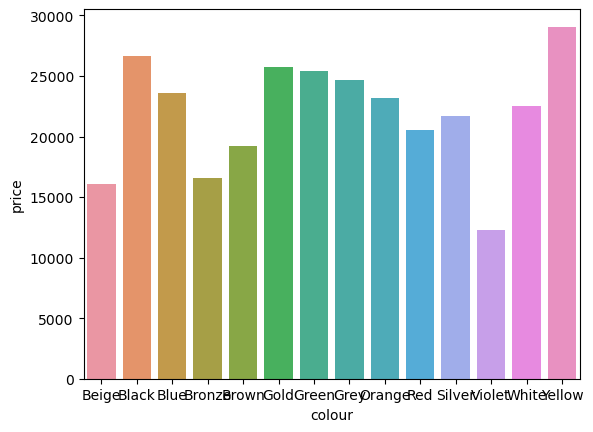

In [99]:
sns.barplot(x = df.groupby("colour").price.mean().index, y = df.groupby("colour").price.mean())

### engine_size

In [100]:
first_looking("engine_size")

column name    :  engine_size
--------------------------------
per_of_nulls   :  % 5.21
num_of_nulls   :  1279
num_of_uniques :  468
--------------------------------
1598.0     1940
999.0      1824
NaN        1279
1969.0      965
1998.0      939
1461.0      933
998.0       849
1199.0      839
1498.0      702
1997.0      622
1968.0      591
1332.0      500
1984.0      422
1499.0      379
1798.0      377
1197.0      355
1995.0      348
898.0       343
1991.0      342
1560.0      341
1242.0      320
1248.0      268
1368.0      265
2143.0      231
1364.0      221
3982.0      199
1950.0      198
5038.0      188
1591.0      186
1956.0      185
1600.0      179
1395.0      167
2435.0      158
3498.0      157
1796.0      154
1500.0      153
2000.0      149
1198.0      148
2996.0      143
1398.0      141
1987.0      140
1149.0      138
1999.0      126
1490.0      125
1496.0      123
1794.0      122
3696.0      120
1497.0      119
2925.0      114
1618.0      113
1587.0      110
875.0       108
14

In [101]:
df.engine_size.fillna("n_n", inplace=True)

In [102]:
df.groupby(["make","body_type","power","engine_size"]).price.describe()

count           mean  \
make   body_type          power engine_size                         
Dacia   Compact           33.0  0.0            1.0   19515.000000   
                                n_n           29.0   22728.517241   
                          49.0  999.0          5.0   13662.000000   
                          50.0  1461.0         2.0    5790.000000   
                          54.0  998.0          3.0   10562.333333   
                                999.0          3.0   10211.333333   
                                n_n            1.0    8990.000000   
                          55.0  999.0         12.0   10713.083333   
                                1149.0        26.0    7451.461538   
                                1390.0         2.0    2672.500000   
                                1461.0        10.0    9138.000000   
                          56.0  1461.0         1.0   10499.000000   
                          62.0  1598.0         2.0    6795.000000   
                          64.0  1598.0         1.0    7700.000000   
                          65.0  1461.0         2.0    8099.000000   
                          66.0  898.0         67.0   11793.208955   
                                899.0          1.0   11990.000000   
                                999.0          2.0   17690.000000   
                                1461.0        20.0   10601.900000   
                          67.0  999.0         19.0   15922.105263   
                                n_n            1.0   18990.000000   
                          68.0  999.0          1.0   15850.000000   
                          70.0  1461.0        14.0   12974.857143   
                          74.0  999.0         17.0   14840.117647   
                          85.0  1461.0         1.0   16500.000000   
        Convertible       66.0  898.0          1.0   12900.000000   
                          84.0  1598.0         1.0   16900.000000   
        Coupe             55.0  1149.0         1.0    9900.000000   
                          66.0  898.0          1.0   12900.000000   
        Off-Road/Pick-up  32.0  n_n            1.0   18490.000000   
                          33.0  n_n            1.0   22980.000000   
                          34.0  n_n            1.0   16499.000000   
                          54.0  998.0          1.0   11499.000000   
                          55.0  1461.0         1.0    7000.000000   
                          63.0  1461.0         1.0    5700.000000   
                          66.0  898.0         10.0   13622.900000   
                                1461.0         7.0   12752.142857   
                                n_n            1.0   11200.000000   
                          67.0  898.0          2.0   11999.000000   
                                999.0         32.0   19325.625000   
                          70.0  1461.0         2.0   13220.000000   
                          74.0  999.0         22.0   19099.636364   
                          75.0  998.0          2.0   14249.000000   
                                999.0          1.0   16200.000000   
                                1598.0         2.0   12490.000000   
                          77.0  1598.0        13.0    9388.000000   
                                1600.0         1.0    7490.000000   
                          79.0  1461.0         1.0   10500.000000   
                          80.0  1461.0        28.0   14369.000000   
                                1500.0         1.0    9990.000000   
                          81.0  1461.0        22.0   13444.681818   
                          84.0  1461.0         2.0   24949.000000   
                                1589.0         1.0   16900.000000   
                                1598.0        26.0   15419.769231   
                                n_n            1.0   11450.000000   
                          85.0  999.0          2.0   20240.000000   
                                1198.0     

In [103]:
df.engine_size.replace("n_n", np.nan, inplace=True)

In [104]:
# fill_bymode_triple(df,"make","body_type","power","engine_size")
# takes too much time

In [105]:
df.cylinders.nunique()

12

In [106]:
df.groupby(["make","body_type","cylinders","engine_size"]).price.describe()

count           mean  \
make    body_type          cylinders engine_size                         
Dacia    Compact           3.0       898.0         60.0   11788.583333   
                                     998.0          1.0   10689.000000   
                                     999.0         50.0   13597.260000   
                           4.0       999.0          2.0   13990.000000   
                                     1149.0        25.0    7473.920000   
                                     1390.0         2.0    2672.500000   
                                     1461.0        47.0   10657.744681   
                                     1598.0         1.0    7700.000000   
         Off-Road/Pick-up  3.0       898.0          1.0    9900.000000   
                                     999.0         11.0   18286.363636   
                           4.0       999.0          2.0   21677.500000   
                                     1461.0        63.0   15958.190476   
                                     1598.0        30.0   13234.933333   
                                     1197.0         9.0   13750.333333   
                                     1199.0         3.0    9916.000000   
                                     1330.0         3.0   17160.000000   
                                     1332.0        18.0   21170.055556   
                                     1333.0         3.0   17900.000000   
                                     1500.0         1.0   19900.000000   
         Sedan             3.0       898.0         22.0   11685.227273   
                                     998.0          7.0   10565.714286   
                                     999.0         20.0   16597.400000   
                                     899.0          2.0   12400.000000   
                           4.0       999.0          1.0   19490.000000   
                                     1149.0         4.0    5449.750000   
                                     1390.0         8.0    3221.250000   
                                     1461.0        14.0    9532.428571   
                                     1598.0         5.0    7452.000000   
                                     1200.0         1.0    4600.000000   
                                     1289.0         1.0    9999.000000   
         Station wagon     3.0       898.0         28.0   11496.142857   
                                     998.0          3.0    8599.666667   
                                     999.0         12.0   19270.333333   
                                     899.0          4.0    7297.250000   
                                     900.0          1.0   13250.000000   
                                     1000.0         1.0    8450.000000   
                           4.0       1149.0         5.0    7575.800000   
                                     1390.0         3.0    4826.666667   
                                     1461.0        37.0    9460.648649   
                                     1598.0        18.0   10499.277778   
                                     1197.0         3.0   12113.000000   
                                     1332.0         2.0   17620.000000   
                                     1500.0         1.0    9450.000000   
                                     1198.0         1.0    5390.000000   
                                     16597.0        1.0   16900.000000   
Fiat     Compact           3.0       998.0          1.0   13950.000000   
                                     999.0         62.0   16245.354839   
                           4.0       999.0          1.0   18230.000000   
                                     1598.0         2.0   12490.000000   
                                     1332.0         1.0   21487.000000   
                                     899.0          1.0    1900.000000   
                                     1200.0         4.0   12040.000000   
                                     1108.0         4.

In [107]:
fill_bymode_triple(df,"make","body_type","cylinders","engine_size")

In [108]:
df.engine_size.isna().sum()

1107

In [109]:
fill_bymode_double(df, "make","body_type","engine_size")

In [110]:
df.engine_size.isna().sum()

0

<Axes: xlabel='engine_size', ylabel='price'>

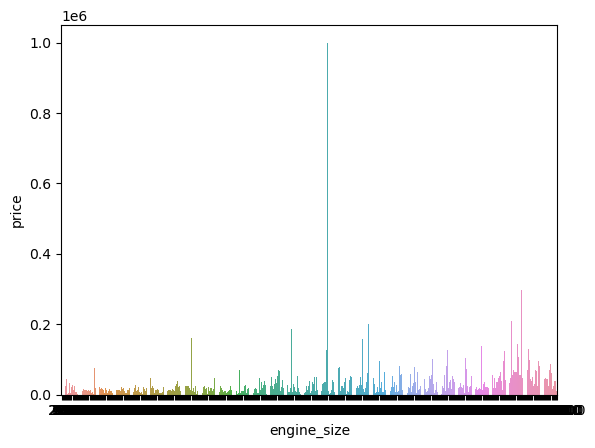

In [111]:
sns.barplot(x = df.groupby("engine_size").price.mean().index, y = df.groupby("engine_size").price.mean())

<Axes: xlabel='price', ylabel='Count'>

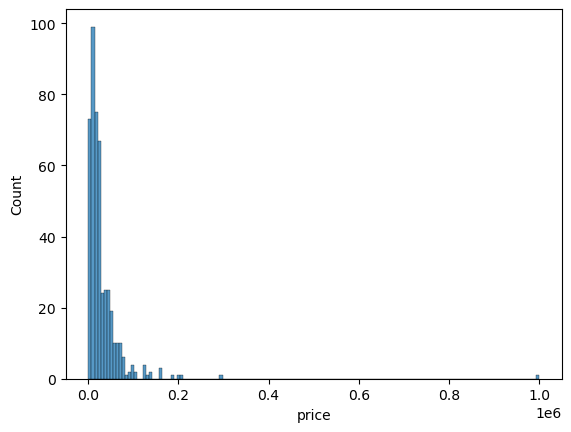

In [112]:
sns.histplot(data=df, x=df.groupby("engine_size").price.mean())

### seats

In [113]:
first_looking("seats")

column name    :  seats
--------------------------------
per_of_nulls   :  % 10.22
num_of_nulls   :  2509
num_of_uniques :  12
--------------------------------
5.0     15839
4.0      4667
NaN      2509
2.0      1060
7.0       346
8.0        43
9.0        35
3.0        24
6.0        12
0.0         9
1.0         6
17.0        2
Name: seats, dtype: int64


<Axes: xlabel='seats', ylabel='Count'>

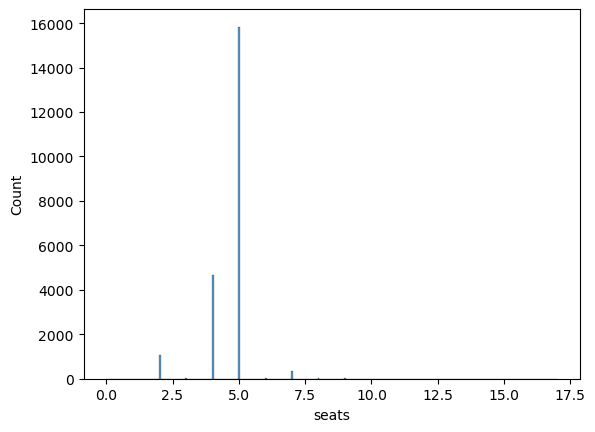

In [114]:
sns.histplot(data=df, x=df.seats)

In [115]:
df.seats.fillna("n_n",inplace=True)

In [116]:
df.groupby(["make","body_type","doors","seats"]).price.describe()

count           mean  \
make          body_type          doors seats                         
Dacia          Compact           4.0   5.0     19.0   11186.526316   
                                       n_n      1.0   11930.000000   
                                 5.0   4.0     28.0   22638.000000   
                                       5.0    193.0   11634.740933   
                                       n_n      2.0   15175.000000   
               Convertible       5.0   n_n      2.0   14900.000000   
               Coupe             5.0   n_n      2.0   11400.000000   
               Off-Road/Pick-up  2.0   2.0      1.0   15490.000000   
                                 4.0   5.0     20.0   16618.700000   
                                       7.0      1.0   24280.000000   
                                 5.0   4.0      3.0   19323.000000   
                                       5.0    302.0   16869.453642   
                                       n_n     13.0   15997.538462   
               Sedan             4.0   2.0      1.0    8900.000000   
                                       5.0     25.0    9896.680000   
                                       n_n      7.0    8548.571429   
                                 5.0   4.0      8.0   21181.875000   
                                       5.0    146.0   12448.486301   
                                       7.0      2.0   19400.000000   
                                       n_n     77.0   11419.571429   
               Station wagon     4.0   2.0      2.0    2244.500000   
                                       5.0     46.0    9507.586957   
                                       7.0      6.0   20644.833333   
                                       n_n     14.0   14038.928571   
                                 5.0   5.0    127.0   11898.637795   
                                       7.0     25.0   18146.560000   
                                       n_n     50.0   13345.280000   
                                 6.0   5.0      4.0    6075.000000   
                                       7.0      1.0    5950.000000   
Fiat           Compact           2.0   2.0      1.0   20000.000000   
                                       4.0     19.0   15537.052632   
                                       5.0      2.0    5170.000000   
                                 3.0   2.0      1.0   55000.000000   
                                       4.0    211.0   14735.260664   
                                       5.0     22.0    6141.727273   
                                       n_n     21.0   15810.619048   
                                 4.0   4.0      4.0   30135.000000   
                                       5.0      5.0   10107.000000   
                                       n_n      1.0    9800.000000   
                                 5.0   4.0     44.0    9700.454545   
                                       5.0     46.0   10128.673913   
                                       n_n      5.0   14997.800000   
               Convertible       1.0   4.0      1.0   19000.000000   
                                 2.0   2.0     54.0   21244.407407   
                                       4.0    164.0   16915.054878   
                                       5.0      1.0   12900.000000   
                                       n_n     19.0   19115.473684   
                                 3.0   2.0      2.0   18880.000000   
                                       4.0     56.0   18711.696429   
                                 4.0   n_n      1.0  159000.000000   
                                 5.0   5.0      3.0   32363.333333   
               Coupe             2.0   1.0      1.0   24500.000000   
                                       2.0     38.0   17514.394737   
                                       3.0      1.0   11500.000000   
                                       4.0    171.0   15618.391813   
                                       5.0     30.0   10

In [117]:
df.seats.replace("n_n",np.nan,inplace=True)

In [118]:
fill_bymode_triple(df,"make","body_type","doors","seats")

<Axes: xlabel='seats', ylabel='Count'>

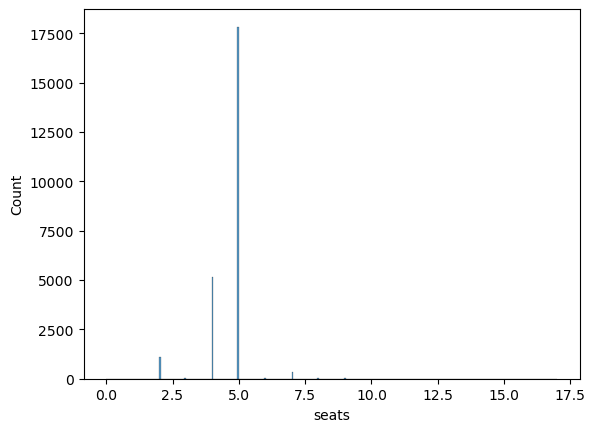

In [119]:
sns.histplot(data=df, x=df.seats)

In [120]:
df.seats.isna().sum()


0

### warranty

In [121]:
first_looking("warranty")

column name    :  warranty
--------------------------------
per_of_nulls   :  % 57.14
num_of_nulls   :  14028
num_of_uniques :  65
--------------------------------
NaN      14028
12.0      7031
24.0      1257
60.0       936
6.0        375
36.0       213
3.0        148
0.0        131
48.0        77
84.0        47
72.0        39
8.0         19
18.0        15
13.0        13
1.0         12
30.0        12
34.0        11
33.0        11
15.0        10
14.0        10
16.0        10
32.0         9
20.0         9
21.0         9
19.0         9
23.0         9
35.0         8
28.0         7
22.0         6
50.0         6
42.0         5
17.0         5
26.0         4
9.0          4
47.0         4
52.0         4
31.0         4
27.0         3
58.0         3
11.0         3
25.0         3
45.0         2
53.0         2
10.0         2
51.0         2
29.0         2
2.0          2
80.0         2
90.0         2
7.0          2
117.0        1
37.0         1
44.0         1
122.0        1
99.0         1
55.0       

In [122]:
df.warranty.fillna("n_n",inplace=True)

In [123]:
df.groupby(["make","body_type","age","warranty"]).price.describe()

count           mean            std  \
make   body_type          age   warranty                                        
Dacia   Compact            0.0  12.0        5.0   14205.400000     303.143200   
                                30.0        1.0   15990.000000            NaN   
                                36.0        8.0   17032.000000    1055.489866   
                                n_n        16.0   16514.250000    3438.934845   
                           1.0  6.0         1.0   15850.000000            NaN   
                                12.0        6.0   15489.666667     677.460159   
                                n_n        32.0   21970.406250    2104.075628   
                           2.0  12.0       11.0   13372.727273    1150.672594   
                                24.0        1.0   12990.000000            NaN   
                                n_n         3.0   13246.666667    2110.694988   
                           3.0  0.0         1.0   10689.000000            NaN   
                                6.0         1.0    8990.000000            NaN   
                                12.0       27.0   11996.333333    1915.593059   
                                15.0        1.0   11500.000000            NaN   
                                19.0        1.0   14480.000000            NaN   
                                24.0        2.0   12400.000000     707.106781   
                                n_n         4.0   13067.500000    2715.159602   
                           4.0  12.0       23.0   11723.739130    1758.974604   
                                n_n         9.0   11586.444444    1320.423617   
                           5.0  12.0       15.0   11353.733333    1044.346170   
                                n_n         6.0   11406.666667    1067.570450   
                           6.0  6.0         1.0    8995.000000            NaN   
                                12.0       16.0   10437.812500    1469.667274   
                                18.0        1.0    9900.000000            NaN   
                                n_n         5.0    8980.000000    1223.928102   
                           7.0  12.0        9.0    9486.555556    2052.698657   
                                24.0        1.0    7950.000000            NaN   
                           8.0  12.0       12.0    7963.250000    2173.040272   
                           9.0  12.0        6.0    7900.000000     900.555384   
                                n_n         1.0    2300.000000            NaN   
                           10.0 12.0        4.0    7899.500000     293.939336   
                                n_n         2.0    5640.000000    1767.766953   
                           11.0 12.0        3.0    6796.666667     260.832002   
                                n_n         1.0    6700.000000            NaN   
                           12.0 12.0        5.0    6204.000000     940.308460   
                           13.0 n_n         2.0    2672.500000     385.373196   
        Convertible        3.0  n_n         2.0   14900.000000    2828.427125   
        Coupe              5.0  n_n         1.0   12900.000000            NaN   
                           6.0  n_n         1.0    9900.000000            NaN   
        Off-Road/Pick-up   0.0  0.0         2.0   21390.000000       0.000000   
                                12.0        3.0   22968.333333    6235.042769   
                                24.0        1.0   24900.000000            NaN   
                                27.0        1.0   22980.000000            NaN   
                                36.0        6.0   23068.333333    2245.773067   
                                n_n        66.0   21010.212121    2406.055447   
                           1.0  0.0         2.0   20300.000000       0.000000   
                                12.0        6.0   18658.666667    2726.166808   
                                24.0        3.0   19583.333333     737.11

In [124]:
df.warranty.replace("n_n",np.nan,inplace=True)

In [125]:
fill_bymode_triple(df,"make","body_type","age","warranty")

<Axes: xlabel='warranty', ylabel='Count'>

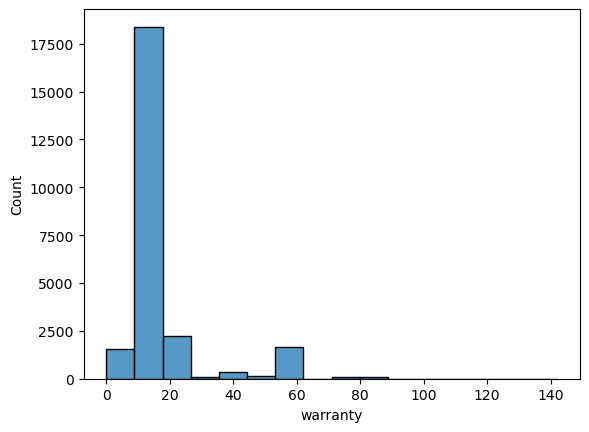

In [126]:
sns.histplot(data=df, x=df.warranty)

### paint	

In [127]:
first_looking("paint")

column name    :  paint
--------------------------------
per_of_nulls   :  % 45.99
num_of_nulls   :  11291
num_of_uniques :  3
--------------------------------
Metallic     13260
NaN          11291
Uni/basic        1
Name: paint, dtype: int64


In [128]:
df.paint.fillna("n_n",inplace=True)

In [129]:
df.groupby(["make","body_type","paint"]).price.describe()

count          mean  \
make          body_type          paint                            
Dacia          Compact           Metallic    79.0  15040.063291   
                                 n_n        164.0  11866.024390   
               Convertible       n_n          2.0  14900.000000   
               Coupe             n_n          2.0  11400.000000   
               Off-Road/Pick-up  Metallic   167.0  17609.652695   
                                 n_n        173.0  16137.826590   
               Sedan             Metallic   101.0  13037.485149   
                                 n_n        165.0  11541.890909   
               Station wagon     Metallic   112.0  13205.321429   
                                 n_n        163.0  11935.957055   
Fiat           Compact           Metallic   128.0  13578.601562   
                                 n_n        254.0  13257.350394   
               Convertible       Metallic   138.0  19073.913043   
                                 n_n        163.0  18563.595092   
               Coupe             Metallic   117.0  14519.623932   
                                 n_n        239.0  16775.188285   
               Off-Road/Pick-up  Metallic   115.0  18800.295652   
                                 n_n        211.0  18808.113744   
               Sedan             Metallic   139.0  15537.417266   
                                 n_n        204.0  14869.431373   
               Station wagon     Metallic    87.0  17582.310345   
                                 n_n        181.0  14671.436464   
Ford           Compact           Metallic   201.0  14562.587065   
                                 n_n        167.0  15085.077844   
               Convertible       Metallic   158.0  35971.202532   
                                 n_n        223.0  37572.188341   
               Coupe             Metallic   139.0  49474.726619   
                                 n_n        219.0  73557.858447   
               Off-Road/Pick-up  Metallic   280.0  33142.328571   
                                 n_n         99.0  33262.060606   
               Sedan             Metallic   247.0  20936.182186   
                                 n_n        136.0  19427.617647   
               Station wagon     Metallic   291.0  25845.054983   
                                 n_n         94.0  23679.255319   
Hyundai        Compact           Metallic    91.0  12988.582418   
                                 n_n        173.0  15973.936416   
               Convertible       Metallic     3.0  17560.000000   
                                 n_n          1.0  31500.000000   
               Coupe             Metallic   129.0  18378.806202   
                                 n_n        175.0  16575.131429   
               Off-Road/Pick-up  Metallic   201.0  27328.646766   
                                 n_n        168.0  25753.565476   
               Sedan             Metallic   171.0  22140.233918   
                                 n_n        201.0  20132.925373   
               Station wagon     Metallic   138.0  16608.905797   
                                 n_n        144.0  15689.930556   
Mercedes-Benz  Compact           Metallic   145.0  35282.455172   
                                 n_n        235.0  33546.927660   
               Convertible       Metallic   283.0  53974.240283   
                                 n_n        112.0  65011.491071   
               Coupe             Metallic   231.0  65620.064935   
                                 n_n        157.0  57741.439490   
               Off-Road/Pick-up  Metallic   241.0  71627.605809   
                                 n_n        152.0  55395.375000   
               Sedan             Metallic   260.0  60966.853846   
                                 n_n        126.0  45724.158730   
               Station wagon     Metallic   271.0  41358.778598   
                                 n_n        119.0  35465.504202   
Nissan         Compact  

In [130]:
df.drop("paint",axis=1,inplace=True)

### empty_weight

In [131]:
first_looking("empty_weight")

column name    :  empty_weight
--------------------------------
per_of_nulls   :  % 38.19
num_of_nulls   :  9376
num_of_uniques :  1219
--------------------------------
NaN        9376
1395.0      230
1055.0      219
1165.0      187
1280.0      171
1320.0      157
1370.0       98
1315.0       97
1090.0       94
1615.0       91
1350.0       91
1485.0       87
1735.0       85
1275.0       83
1295.0       83
1345.0       82
1355.0       81
1390.0       78
1500.0       77
980.0        76
1365.0       76
1310.0       75
1135.0       74
1430.0       73
1505.0       73
1050.0       72
1180.0       69
1255.0       69
1015.0       65
1425.0       65
1065.0       64
1375.0       64
1045.0       61
1445.0       59
1733.0       59
1115.0       59
1680.0       58
1260.0       57
1575.0       56
950.0        56
1040.0       56
905.0        53
1270.0       53
1610.0       52
1555.0       51
1470.0       51
1305.0       51
1245.0       50
1265.0       49
1845.0       49
1125.0       48
1250.0       47

In [132]:
df.empty_weight.fillna("n_n",inplace=True)

In [133]:
df.groupby(["make","body_type","engine_size","empty_weight"]).price.describe()

count           mean  \
make  body_type          engine_size empty_weight                         
Dacia  Compact           0.0         1045.0          1.0   19515.000000   
                         898.0       920.0           1.0   19950.000000   
                                     955.0           3.0   11028.000000   
                                     962.0           2.0    9449.500000   
                                     980.0           2.0   12245.000000   
                                     1023.0         14.0   10564.714286   
                                     1026.0          2.0   22985.000000   
                                     1040.0         32.0   12403.000000   
                                     1045.0         23.0   23006.956522   
                                     1055.0          1.0    9990.000000   
                                     1061.0          1.0    9290.000000   
                                     1064.0          1.0   14950.000000   
                                     1069.0          1.0   11950.000000   
                                     1098.0          2.0   10445.000000   
                                     1113.0          1.0   11980.000000   
                                     1115.0          2.0   11690.000000   
                                     1157.0          1.0   18990.000000   
                                     n_n             9.0   15497.444444   
                         899.0       n_n             1.0   11990.000000   
                         998.0       n_n             3.0   10562.333333   
                         999.0       969.0          15.0   11397.600000   
                                     973.0           3.0   11137.000000   
                                     1015.0          3.0   14066.666667   
                                     1027.0          1.0   14100.000000   
                                     1045.0          1.0   10900.000000   
                                     1049.0          1.0    9500.000000   
                                     1063.0          1.0   14990.000000   
                                     1071.0          1.0   15850.000000   
                                     1072.0          3.0   13108.333333   
                                     1089.0          1.0   12010.000000   
                                     1096.0          5.0   15737.200000   
                                     1099.0          1.0   19299.000000   
                                     1127.0          2.0   15930.000000   
                                     1130.0          1.0   15990.000000   
                                     1147.0          2.0   17690.000000   
                                     1154.0          3.0   16582.666667   
                                     1209.0          2.0   15165.000000   
                                     1250.0          1.0   13760.000000   
                                     n_n            12.0   16269.166667   
                         1149.0      941.0          15.0    7912.000000   
                                     950.0           1.0    4390.000000   
                                     974.0           3.0    7716.000000   
                                     975.0           6.0    6771.666667   
                                     n_n             1.0    6890.000000   
                         1390.0      950.0           1.0    2400.000000   
                                     1011.0          1.0    2945.000000   
                         1461.0      1033.0         12.0    9796.583333   
                                     1055.0          1.0    9900.000000   
                                     1059.0          2.0    8322.500000   
                                     1080.0          1.0   10900.000000   
                                     1085.0          7.0   10247.142857   
                                     1087.0          1.0   10400.000000   
 

In [134]:
df.empty_weight.replace("n_n",np.nan,inplace=True)

<Axes: xlabel='empty_weight', ylabel='price'>

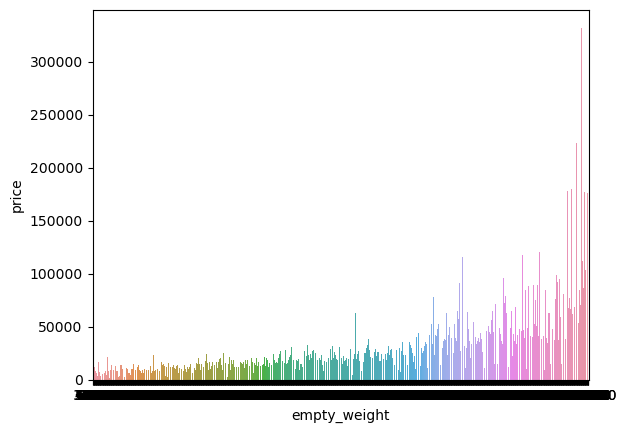

In [135]:
sns.barplot(x = df.groupby("empty_weight").price.mean().index, y = df.groupby("empty_weight").price.mean())

In [136]:
fill_bymode_triple(df,"make","body_type","engine_size","empty_weight")

<Axes: xlabel='empty_weight', ylabel='price'>

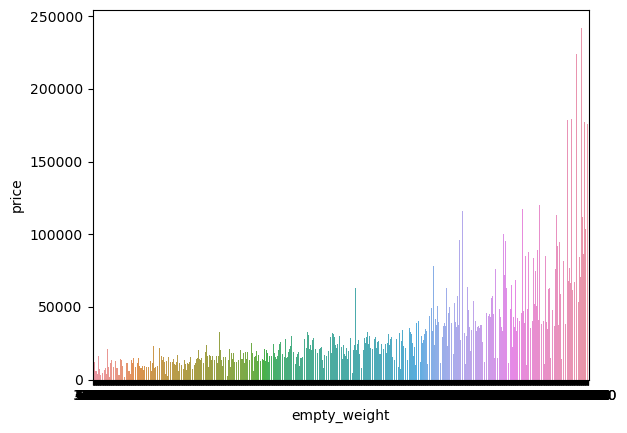

In [137]:
sns.barplot(x = df.groupby("empty_weight").price.mean().index, y = df.groupby("empty_weight").price.mean())

### cylinders

In [138]:
first_looking("cylinders")

column name    :  cylinders
--------------------------------
per_of_nulls   :  % 34.17
num_of_nulls   :  8389
num_of_uniques :  13
--------------------------------
4.0     11126
NaN      8389
3.0      2961
6.0       948
8.0       520
5.0       439
2.0        99
0.0        33
1.0        21
12.0        8
7.0         6
26.0        1
16.0        1
Name: cylinders, dtype: int64


<Axes: xlabel='cylinders', ylabel='price'>

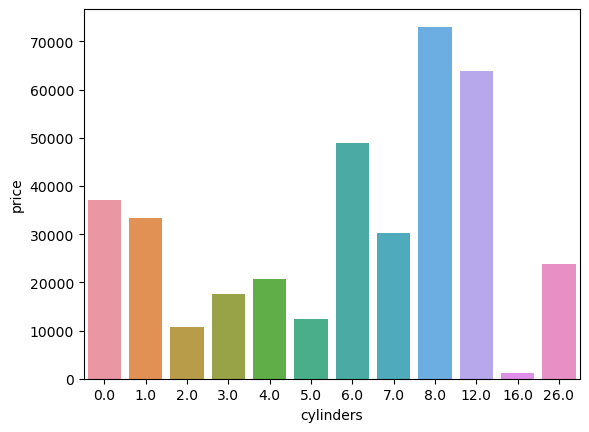

In [139]:
sns.barplot(x = df.groupby("cylinders").price.mean().index, y = df.groupby("cylinders").price.mean())

In [140]:
df.cylinders.fillna("n_n",inplace=True)

In [141]:
df.groupby(["make","body_type","engine_size","cylinders"]).price.describe()

count           mean  \
make   body_type          engine_size cylinders                         
Dacia   Compact           0.0         n_n          1.0   19515.000000   
                          898.0       3.0         60.0   11788.583333   
                                      n_n         38.0   20261.500000   
                          899.0       n_n          1.0   11990.000000   
                          998.0       3.0          1.0   10689.000000   
                                      n_n          2.0   10499.000000   
                          999.0       3.0         50.0   13597.260000   
                                      4.0          2.0   13990.000000   
                                      n_n          7.0   17955.714286   
                          1149.0      4.0         25.0    7473.920000   
                                      n_n          1.0    6890.000000   
                          1390.0      4.0          2.0    2672.500000   
                          1461.0      4.0         47.0   10657.744681   
                                      n_n          3.0   12976.333333   
                          1598.0      4.0          1.0    7700.000000   
                                      n_n          2.0    6795.000000   
        Convertible       898.0       n_n          1.0   12900.000000   
                          1598.0      n_n          1.0   16900.000000   
        Coupe             898.0       n_n          1.0   12900.000000   
                          1149.0      n_n          1.0    9900.000000   
        Off-Road/Pick-up  332.0       n_n          1.0   21980.000000   
                          898.0       3.0          1.0    9900.000000   
                                      n_n         11.0   13666.090909   
                          998.0       n_n          3.0   13332.333333   
                          999.0       3.0         11.0   18286.363636   
                                      4.0          2.0   21677.500000   
                                      n_n         44.0   19336.068182   
                          1197.0      4.0          9.0   13750.333333   
                                      n_n          7.0   16578.285714   
                          1198.0      n_n          1.0   13490.000000   
                          1199.0      4.0          3.0    9916.000000   
                          1200.0      n_n          2.0   13990.000000   
                          1300.0      n_n          2.0   15917.500000   
                          1330.0      4.0          3.0   17160.000000   
                          1332.0      4.0         18.0   21170.055556   
                                      n_n         23.0   20822.913043   
                          1333.0      4.0          3.0   17900.000000   
                                      n_n          6.0   20671.166667   
                          1461.0      4.0         63.0   15958.190476   
                                      6.0          5.0   20830.000000   
                                      n_n         75.0   16559.693333   
                          1500.0      4.0          1.0   19900.000000   
                                      n_n          1.0    9990.000000   
                          1589.0      n_n          1.0   16900.000000   
                          1598.0      4.0         30.0   13234.933333   
                                      n_n         13.0   13868.461538   
                          1600.0      n_n          1.0    7490.000000   
        Sedan             0.0         n_n          1.0   18400.000000   
                          898.0       3.0         22.0   11685.227273   
                                      n_n         31.0   11267.161290   
                          899.0       3.0          2.0   12400.000000   
                          900.0       n_n         20.0   11353.650000   
                          998.0       3.0          7.0   10565.714286   
                                  

In [142]:
df.cylinders.replace("n_n",np.nan, inplace=True)

In [143]:
fill_bymode_triple(df,"make","body_type","engine_size","cylinders")

<Axes: xlabel='cylinders', ylabel='price'>

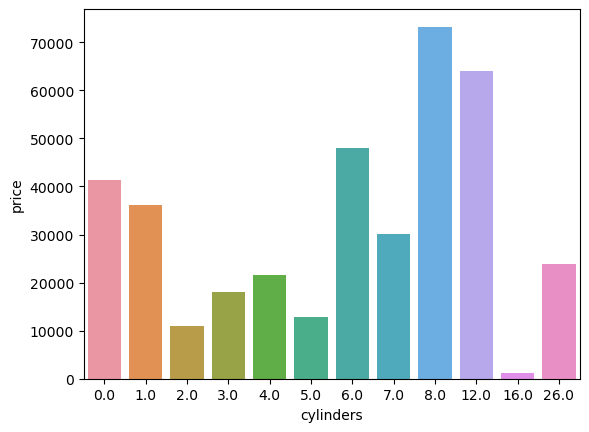

In [144]:
sns.barplot(x = df.groupby("cylinders").price.mean().index, y = df.groupby("cylinders").price.mean())

### drivetrain

In [145]:
first_looking("drivetrain")

column name    :  drivetrain
--------------------------------
per_of_nulls   :  % 42.43
num_of_nulls   :  10417
num_of_uniques :  4
--------------------------------
NaN        10417
 Front      9961
 4WD        2752
 Rear       1422
Name: drivetrain, dtype: int64


<Axes: xlabel='drivetrain', ylabel='price'>

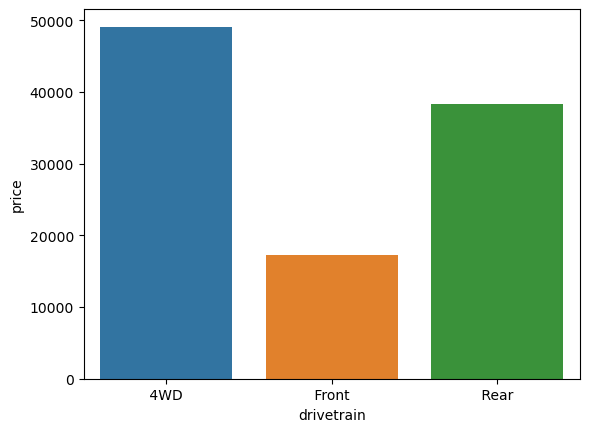

In [146]:
sns.barplot(x = df.groupby("drivetrain").price.mean().index, y = df.groupby("drivetrain").price.mean())

In [147]:
df.drivetrain.fillna("n_n",inplace=True)

In [148]:
df.groupby(["make",'body_type','drivetrain']).price.describe()

count           mean  \
make          body_type          drivetrain                         
Dacia          Compact            Front      181.0   11308.801105   
                                 n_n          62.0   17537.096774   
               Convertible       n_n           2.0   14900.000000   
               Coupe             n_n           2.0   11400.000000   
               Off-Road/Pick-up   4WD         56.0   18665.642857   
                                  Front      103.0   15372.194175   
                                  Rear         1.0   20750.000000   
                                 n_n         180.0   17129.411111   
               Sedan              Front       72.0   12176.416667   
                                 n_n         194.0   12085.030928   
               Station wagon      4WD          2.0   15745.000000   
                                  Front       79.0   11340.088608   
                                  Rear         1.0    9500.000000   
                                 n_n         193.0   12889.637306   
Fiat           Compact            4WD         13.0   11032.000000   
                                  Front      261.0   12849.992337   
                                  Rear         4.0   20862.500000   
                                 n_n         104.0   14660.711538   
               Convertible        Front      183.0   17829.584699   
                                  Rear        38.0   23851.736842   
                                 n_n          80.0   18611.075000   
               Coupe              4WD          2.0    9000.000000   
                                  Front      128.0   12729.460938   
                                  Rear        48.0   29253.354167   
                                 n_n         178.0   14924.348315   
               Off-Road/Pick-up   4WD         41.0   17639.219512   
                                  Front      184.0   18858.010870   
                                  Rear         1.0   22990.000000   
                                 n_n         100.0   19144.740000   
               Sedan              4WD         16.0   15203.062500   
                                  Front      235.0   15607.842553   
                                  Rear         3.0   10033.333333   
                                 n_n          89.0   14065.988764   
               Station wagon      4WD          3.0   16223.333333   
                                  Front      139.0   15983.561151   
                                 n_n         126.0   15196.873016   
Ford           Compact            4WD          7.0   36055.714286   
                                  Front      217.0   13827.465438   
                                  Rear         1.0   22500.000000   
                                 n_n         143.0   15180.685315   
               Convertible        4WD          2.0   28350.000000   
                                  Front       28.0   13273.607143   
                                  Rear       155.0   45531.141935   
                                 n_n         196.0   33552.857143   
               Coupe              4WD          2.0  206750.000000   
                                  Front        7.0    6341.285714   
                                  Rear       148.0   55007.824324   
                                 n_n         201.0   71577.666667   
               Off-Road/Pick-up   4WD        166.0   40840.445783   
                                  Front       92.0   25017.543478   
                                  Rear         3.0   70280.000000   
                                 n_n         118.0   27803.627119   
               Sedan              4WD          7.0   36817.142857   
                                  Front      163.0   19721.159509   
                                 n_n         213.0   20380.863850   
               Station wagon      4WD          6.0   34607.500000   
                                  Front    

In [149]:
df.drivetrain.replace("n_n",np.nan,inplace=True)

In [150]:
fill_bymode_double(df, "make","body_type", 'drivetrain')

<Axes: xlabel='drivetrain', ylabel='price'>

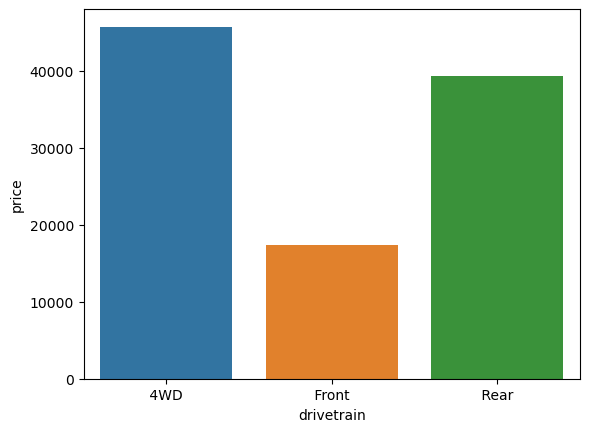

In [151]:
sns.barplot(x = df.groupby("drivetrain").price.mean().index, y = df.groupby("drivetrain").price.mean())

### co_emissions

In [152]:
first_looking('co_emissions')

column name    :  co_emissions
--------------------------------
per_of_nulls   :  % 30.75
num_of_nulls   :  7549
num_of_uniques :  334
--------------------------------
NaN        7549
0.0         994
119.0       365
124.0       319
99.0        300
114.0       291
115.0       275
139.0       274
129.0       273
109.0       260
108.0       246
125.0       234
130.0       226
149.0       218
110.0       210
120.0       207
123.0       199
126.0       198
117.0       192
111.0       190
104.0       188
112.0       181
127.0       180
116.0       172
145.0       166
122.0       165
107.0       164
135.0       163
138.0       162
95.0        162
178.0       161
113.0       159
134.0       155
121.0       155
103.0       153
128.0       151
106.0       151
133.0       149
154.0       143
93.0        141
105.0       137
118.0       136
98.0        135
140.0       135
88.0        134
102.0       133
136.0       130
159.0       130
155.0       130
148.0       129
156.0       128
131.0       125


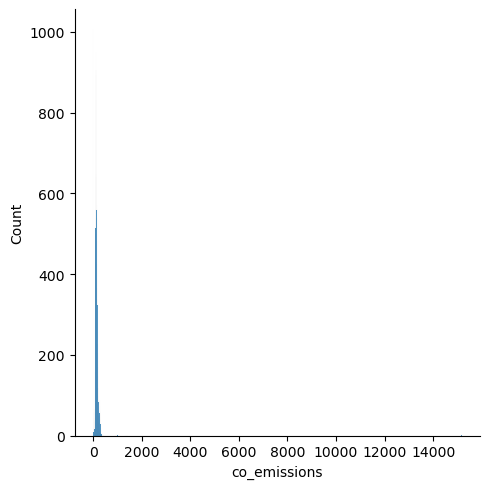

In [153]:
sns.displot(x=df.co_emissions)

<Axes: xlabel='co_emissions', ylabel='price'>

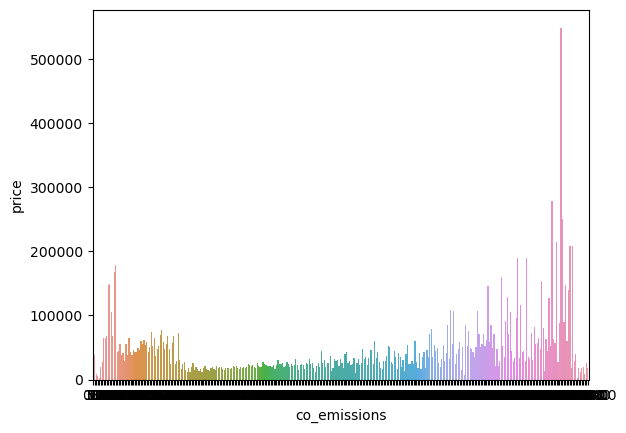

In [154]:
sns.barplot(x = df.groupby("co_emissions").price.mean().index, y = df.groupby("co_emissions").price.mean())

In [155]:
df.co_emissions.fillna("n_n",inplace=True)

In [156]:
df.groupby(["make","body_type","co_emissions"]).price.describe()

count          mean            std  \
make   body_type          co_emissions                                       
Dacia   Compact           0.0             2.0  14470.000000     678.822510   
                          90.0            1.0  10499.000000            NaN   
                          96.0            1.0  10880.000000            NaN   
                          101.0           1.0   9640.000000            NaN   
                          109.0           1.0  10590.000000            NaN   
                          110.0           5.0  11492.800000    1937.205900   
                          111.0           1.0  14080.000000            NaN   
                          113.0           5.0  12693.400000    3022.792798   
                          114.0           3.0  12823.333333    1434.793830   
                          115.0           5.0  12324.000000    2391.229809   
                          116.0           1.0   9390.000000            NaN   
                          117.0           9.0  13895.555556    3659.880842   
                          119.0           8.0  17160.000000    2755.441370   
                          120.0           1.0  12490.000000            NaN   
                          121.0           2.0  13975.000000     176.776695   
                          127.0           1.0  16690.000000            NaN   
                          130.0           2.0  13545.000000    3754.737008   
                          135.0           1.0   4390.000000            NaN   
                          137.0           1.0   6890.000000            NaN   
                          161.0           1.0   2400.000000            NaN   
                          165.0           1.0   2945.000000            NaN   
                          173.0           2.0   6795.000000     134.350288   
                          n_n           188.0  12991.372340    5008.750938   
        Convertible       n_n             2.0  14900.000000    2828.427125   
        Coupe             n_n             2.0  11400.000000    2121.320344   
        Off-Road/Pick-up  0.0            16.0  17036.187500    1839.808839   
                          90.0            1.0   7000.000000            NaN   
                          96.0            1.0  10950.000000            NaN   
                          105.0           2.0  17490.000000       0.000000   
                          108.0           3.0  16166.333333     763.217094   
                          110.0           1.0  17990.000000            NaN   
                          112.0           1.0  23556.000000            NaN   
                          114.0           2.0  14945.000000      63.639610   
                          115.0          24.0  14212.750000    2414.177621   
                          116.0           8.0  15612.500000    3151.053112   
                          117.0           2.0  11749.000000     353.553391   
                          118.0           1.0  22990.000000            NaN   
                          119.0          37.0  19519.135135    1672.587785   
                          121.0           3.0  26220.666667    3232.476038   
                          122.0           1.0  24280.000000            NaN   
                          123.0           7.0  15801.285714    3851.421587   
                          124.0           6.0  22364.666667    6107.788656   
                          125.0           1.0  16980.000000            NaN   
                          126.0           2.0  16694.500000    1703.420236   
                          127.0           5.0  17584.000000    4320.767293   
                          128.0           1.0  20850.000000            NaN   
                          129.0           5.0  18652.000000    1887.251970   
                          130.0           3.0  15003.333333    5144.514878   
                          131.0           9.0  21764.000000     506.762025   
                          132.0           6.0  21644.166667   

In [157]:
df.groupby(["make","body_type","fuel_type","co_emissions"]).price.describe()

count           mean  \
make  body_type          fuel_type   co_emissions                         
Dacia  Compact           benzine     0.0             2.0   14470.000000   
                                     109.0           1.0   10590.000000   
                                     110.0           5.0   11492.800000   
                                     111.0           1.0   14080.000000   
                                     113.0           5.0   12693.400000   
                                     114.0           2.0   11995.000000   
                                     115.0           5.0   12324.000000   
                                     116.0           1.0    9390.000000   
                                     117.0           6.0   13960.000000   
                                     119.0           6.0   17986.666667   
                                     120.0           1.0   12490.000000   
                                     121.0           2.0   13975.000000   
                                     127.0           1.0   16690.000000   
                                     130.0           1.0   10890.000000   
                                     135.0           1.0    4390.000000   
                                     137.0           1.0    6890.000000   
                                     161.0           1.0    2400.000000   
                                     165.0           1.0    2945.000000   
                                     173.0           2.0    6795.000000   
                                     n_n           134.0   13592.246269   
                         diesel      90.0            1.0   10499.000000   
                                     96.0            1.0   10880.000000   
                                     101.0           1.0    9640.000000   
                                     n_n            47.0   10826.042553   
                         electric    n_n             1.0   19515.000000   
                         gas         114.0           1.0   14480.000000   
                                     117.0           3.0   13766.666667   
                                     119.0           2.0   14680.000000   
                                     n_n             6.0   15446.333333   
                         gas_benzine 130.0           1.0   16200.000000   
       Convertible       benzine     n_n             1.0   12900.000000   
                         gas         n_n             1.0   16900.000000   
       Coupe             benzine     n_n             2.0   11400.000000   
       Off-Road/Pick-up  benzine     0.0            10.0   16385.000000   
                                     114.0           2.0   14945.000000   
                                     115.0           4.0   12199.250000   
                                     116.0           2.0   16440.000000   
                                     117.0           1.0   11499.000000   
                                     119.0          27.0   18986.296296   
                                     121.0           3.0   26220.666667   
                                     127.0           3.0   17980.000000   
                                     131.0           9.0   21764.000000   
                                     134.0           1.0   13999.000000   
                                     137.0           1.0   15290.000000   
                                     138.0          17.0   15762.529412   
                                     139.0           3.0   23487.666667   
                                     140.0           3.0   14269.666667   
                                     141.0           2.0   25439.500000   
                                     143.0           2.0   15515.000000   
                                     145.0           9.0   15355.555556   
                                     148.0           2.0   15425.000000   
                                     149.0           5.0   17092.000000   
 

In [158]:
df.co_emissions.replace("n_n",np.nan,inplace=True)

In [159]:
fill_bymode_triple(df,"make","body_type","fuel_type","co_emissions")

<Axes: xlabel='co_emissions', ylabel='price'>

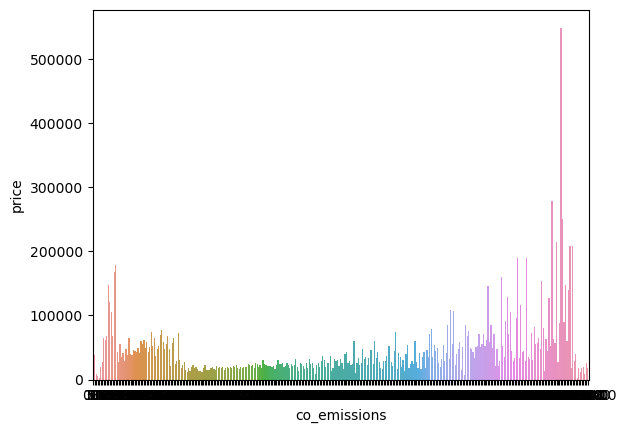

In [160]:
sns.barplot(x = df.groupby("co_emissions").price.mean().index, y = df.groupby("co_emissions").price.mean())

In [161]:
df.co_emissions.isna().sum()

0

### emission_class

In [162]:
first_looking("emission_class")

column name    :  emission_class
--------------------------------
per_of_nulls   :  % 33.22
num_of_nulls   :  8157
num_of_uniques :  10
--------------------------------
NaN             8157
Euro 6          5991
Euro 6d-TEMP    3101
Euro 6d         2623
Euro 5          2233
Euro 4          1515
Euro 3           448
Euro 2           196
Euro 1           160
Euro 6c          128
Name: emission_class, dtype: int64


<Axes: xlabel='emission_class', ylabel='price'>

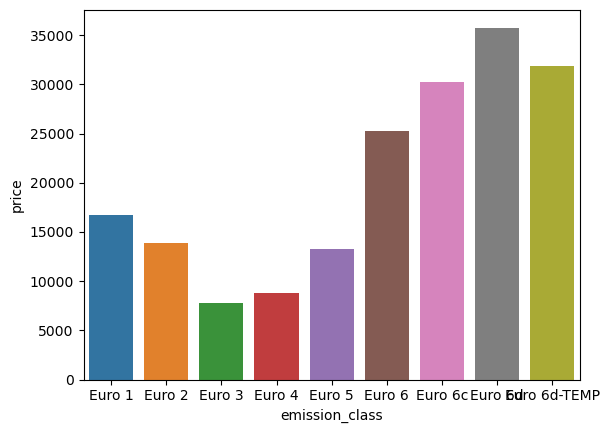

In [163]:
sns.barplot(x = df.groupby("emission_class").price.mean().index, y = df.groupby("emission_class").price.mean())

In [164]:
df.emission_class.fillna("n_n",inplace=True)

In [165]:
df.emission_class.value_counts()

n_n             8157
Euro 6          5991
Euro 6d-TEMP    3101
Euro 6d         2623
Euro 5          2233
Euro 4          1515
Euro 3           448
Euro 2           196
Euro 1           160
Euro 6c          128
Name: emission_class, dtype: int64

In [166]:
df.groupby(['make','body_type','co_emissions','emission_class']).price.describe()

count           mean  \
make  body_type          co_emissions emission_class                         
Dacia  Compact           0.0          Euro 6            1.0   13990.000000   
                                      n_n               1.0   14950.000000   
                         90.0         n_n              49.0   10996.693878   
                         96.0         Euro 6c           1.0   10880.000000   
                         101.0        Euro 5            1.0    9640.000000   
                         109.0        Euro 6            1.0   10590.000000   
                         110.0        Euro 6            5.0   11492.800000   
                         111.0        Euro 6            1.0   14080.000000   
                         113.0        Euro 6            2.0   12734.500000   
                                      Euro 6d-TEMP      1.0   17000.000000   
                                      n_n               2.0   10499.000000   
                         114.0        Euro 6            3.0   12823.333333   
                         115.0        Euro 6            5.0   12324.000000   
                         116.0        Euro 6            1.0    9390.000000   
                         117.0        Euro 6           27.0   21472.962963   
                                      Euro 6c           1.0   10900.000000   
                                      Euro 6d           2.0   22389.000000   
                                      Euro 6d-TEMP      6.0   19966.500000   
                                      n_n             113.0   11361.522124   
                         119.0        Euro 6            5.0   16132.000000   
                                      Euro 6d           2.0   18615.000000   
                                      Euro 6d-TEMP      1.0   19390.000000   
                         120.0        Euro 6            1.0   12490.000000   
                         121.0        Euro 6d           1.0   14100.000000   
                                      n_n               1.0   13850.000000   
                         127.0        Euro 6            1.0   16690.000000   
                         130.0        Euro 6            1.0   10890.000000   
                                      Euro 6d           1.0   16200.000000   
                         135.0        Euro 5            1.0    4390.000000   
                         137.0        n_n               1.0    6890.000000   
                         161.0        Euro 4            1.0    2400.000000   
                         165.0        n_n               1.0    2945.000000   
                         173.0        Euro 5            2.0    6795.000000   
       Convertible       117.0        n_n               2.0   14900.000000   
       Coupe             117.0        n_n               2.0   11400.000000   
       Off-Road/Pick-up  0.0          Euro 5            1.0   15490.000000   
                                      Euro 6           12.0   16967.500000   
                                      Euro 6d-TEMP      1.0   18490.000000   
                                      n_n               2.0   17494.500000   
                         90.0         Euro 6            1.0    7000.000000   
                         96.0         Euro 6d-TEMP      1.0   10950.000000   
                         105.0        Euro 6            2.0   17490.000000   
                         108.0        Euro 6            1.0   15500.000000   
                                      Euro 6d-TEMP      1.0   16000.000000   
                                      n_n               1.0   16999.000000   
                         110.0        n_n               1.0   17990.000000   
                         112.0        Euro 6            1.0   23556.000000   
                         114.0        Euro 6            2.0   14945.000000   
                         115.0        Euro 6           10.0   14137.300000   
                                      Euro 6d           1.0   19900.000000  

<Axes: ylabel='emission_class'>

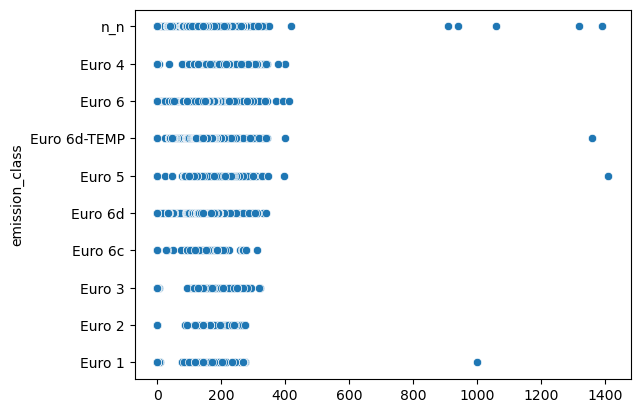

In [167]:
sns.scatterplot(x=[i if i <2000 else np.nan for i in df.co_emissions],y=df.emission_class)

<Axes: xlabel='age', ylabel='emission_class'>

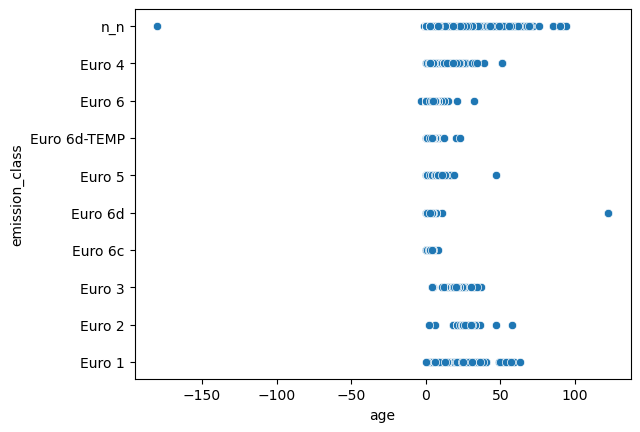

In [168]:
sns.scatterplot(x=df.age, y=df.emission_class)

<Axes: xlabel='engine_size', ylabel='emission_class'>

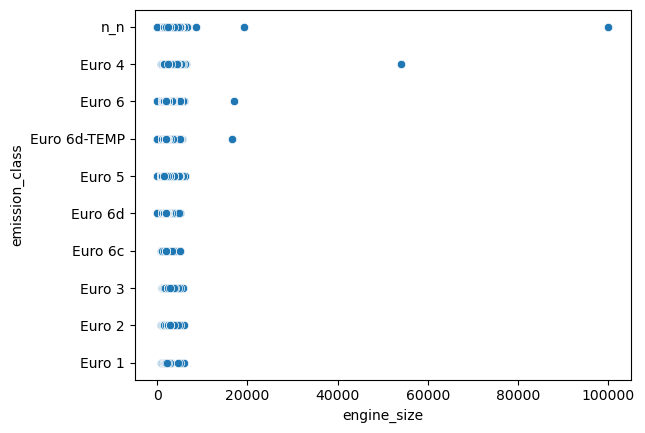

In [169]:
sns.scatterplot(x=df.engine_size, y=df.emission_class)

<Axes: xlabel='cylinders', ylabel='emission_class'>

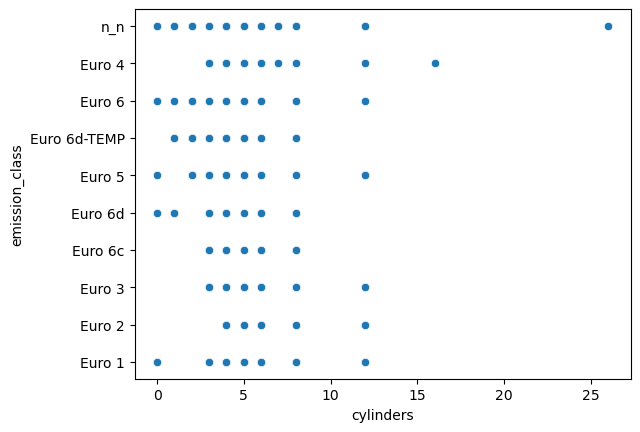

In [170]:
sns.scatterplot(x=df.cylinders, y=df.emission_class)

In [171]:
df.groupby(['make','body_type','age','emission_class']).price.describe()

count           mean  \
make   body_type          age   emission_class                         
Dacia   Compact            0.0  Euro 6           11.0   14802.727273   
                                Euro 6d           5.0   19221.600000   
                                Euro 6d-TEMP      4.0   18440.000000   
                                n_n              10.0   15480.300000   
                           1.0  Euro 6           25.0   22460.400000   
                                Euro 6d           1.0   16200.000000   
                                Euro 6d-TEMP      4.0   20607.250000   
                                n_n               9.0   16855.777778   
                           2.0  Euro 6c           1.0   10900.000000   
                                n_n              14.0   13495.000000   
                           3.0  Euro 6            3.0   13053.000000   
                                Euro 6c           1.0   10880.000000   
                                n_n              33.0   12017.909091   
                           4.0  Euro 6            8.0   11742.375000   
                                n_n              24.0   11666.041667   
                           5.0  Euro 6            3.0   12156.666667   
                                n_n              18.0   11237.555556   
                           6.0  Euro 5            1.0    9640.000000   
                                Euro 6            4.0    9416.250000   
                                n_n              18.0   10194.166667   
                           7.0  n_n              10.0    9332.900000   
                           8.0  n_n              12.0    7963.250000   
                           9.0  n_n               7.0    7100.000000   
                           10.0 Euro 5            2.0    5640.000000   
                                n_n               4.0    7899.500000   
                           11.0 Euro 5            1.0    6700.000000   
                                n_n               3.0    6796.666667   
                           12.0 n_n               5.0    6204.000000   
                           13.0 Euro 4            1.0    2400.000000   
                                n_n               1.0    2945.000000   
        Convertible        3.0  n_n               2.0   14900.000000   
        Coupe              5.0  n_n               1.0   12900.000000   
                           6.0  n_n               1.0    9900.000000   
        Off-Road/Pick-up   0.0  Euro 6           32.0   19777.437500   
                                Euro 6c           2.0   23190.000000   
                                Euro 6d          21.0   22359.904762   
                                Euro 6d-TEMP      8.0   23707.250000   
                                n_n              16.0   21635.937500   
                           1.0  Euro 6            6.0   19481.666667   
                                Euro 6d           5.0   23112.000000   
                                Euro 6d-TEMP     11.0   20188.000000   
                                n_n              13.0   19670.846154   
                           2.0  Euro 6            5.0   17682.000000   
                                Euro 6c           1.0   15480.000000   
                                Euro 6d           1.0   21690.000000   
                                Euro 6d-TEMP      7.0   18111.285714   
                                n_n              14.0   17973.785714   
                           3.0  Euro 6           21.0   16475.190476   
                                Euro 6c           6.0   15691.666667   
                                Euro 6d-TEMP     11.0   17536.909091   
                                n_n              24.0   16135.333333   
                           4.0  Euro 6           29.0   15000.068966   
                                Euro 6d-TEMP      2.0   15740.000000   
                                n_n              31.0   15245.419355   
                

In [172]:
df.emission_class.replace('n_n',np.nan,inplace=True)

In [173]:
fill_bymode_triple(df,'make','body_type','age','emission_class')

<Axes: xlabel='emission_class', ylabel='price'>

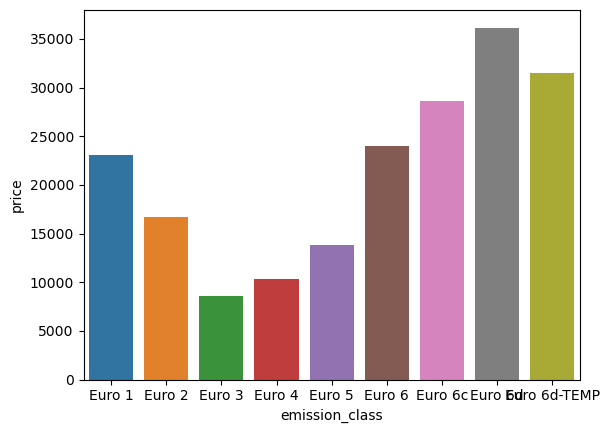

In [174]:
sns.barplot(x = df.groupby("emission_class").price.mean().index, y = df.groupby("emission_class").price.mean())

In [175]:
df.emission_class.isna().sum()

0

In [176]:
df.emission_class.value_counts()

Euro 6          10203
Euro 6d-TEMP     4036
Euro 6d          3468
Euro 5           3055
Euro 4           2193
Euro 3            671
Euro 2            415
Euro 1            369
Euro 6c           142
Name: emission_class, dtype: int64

### full_service_history

In [177]:
first_looking('full_service_history')

column name    :  full_service_history
--------------------------------
per_of_nulls   :  % 52.91
num_of_nulls   :  12990
num_of_uniques :  2
--------------------------------
NaN    12990
Yes    11562
Name: full_service_history, dtype: int64


In [178]:
df.full_service_history.fillna("n_n",inplace=True)

In [179]:
df.groupby(["make",'body_type','age','full_service_history']).price.describe()

count           mean  \
make   body_type          age   full_service_history                         
Dacia   Compact            0.0  Yes                    15.0   16149.200000   
                                n_n                    15.0   16350.866667   
                           1.0  Yes                    28.0   22426.071429   
                                n_n                    11.0   16719.181818   
                           2.0  n_n                    15.0   13322.000000   
                           3.0  Yes                     3.0   13273.333333   
                                n_n                    34.0   11965.000000   
                           4.0  Yes                     4.0   12267.250000   
                                n_n                    28.0   11601.964286   
                           5.0  Yes                     2.0   12485.000000   
                                n_n                    19.0   11251.368421   
                           6.0  Yes                     2.0    8440.000000   
                                n_n                    21.0   10186.666667   
                           7.0  n_n                    10.0    9332.900000   
                           8.0  n_n                    12.0    7963.250000   
                           9.0  n_n                     7.0    7100.000000   
                           10.0 Yes                     2.0    5640.000000   
                                n_n                     4.0    7899.500000   
                           11.0 Yes                     1.0    6700.000000   
                                n_n                     3.0    6796.666667   
                           12.0 n_n                     5.0    6204.000000   
                           13.0 Yes                     1.0    2945.000000   
                                n_n                     1.0    2400.000000   
        Convertible        3.0  n_n                     2.0   14900.000000   
        Coupe              5.0  n_n                     1.0   12900.000000   
                           6.0  n_n                     1.0    9900.000000   
        Off-Road/Pick-up   0.0  Yes                    28.0   22954.071429   
                                n_n                    51.0   20430.098039   
                           1.0  Yes                     9.0   20514.222222   
                                n_n                    26.0   20215.807692   
                           2.0  Yes                    13.0   18108.384615   
                                n_n                    15.0   17905.533333   
                           3.0  Yes                    20.0   16670.100000   
                                n_n                    42.0   16354.309524   
                           4.0  Yes                    24.0   15332.000000   
                                n_n                    38.0   15029.526316   
                           5.0  Yes                     8.0   15046.250000   
                                n_n                    19.0   13978.789474   
                           6.0  Yes                     6.0   12598.333333   
                                n_n                    10.0   12191.500000   
                           7.0  Yes                     1.0   15490.000000   
                                n_n                     5.0   10945.600000   
                           8.0  n_n                     8.0   10357.375000   
                           9.0  Yes                     2.0    9699.500000   
                                n_n                     2.0    9975.000000   
                           10.0 Yes                     1.0    8450.000000   
                                n_n                     5.0    7616.000000   
                           11.0 Yes                     2.0    6447.500000   
                                n_n                     2.0    9495.000000   
                           12.0 n_n                     3.0    6696.666667  

In [180]:
df.age.value_counts()

 3.0      3108
 0.0      2806
 4.0      2753
 1.0      2598
 2.0      2170
 5.0      2004
 6.0      1255
 7.0       954
 8.0       758
 9.0       626
 10.0      593
 11.0      572
 12.0      486
 15.0      389
 13.0      373
 14.0      369
 16.0      354
 17.0      273
 18.0      219
 19.0      177
 20.0      162
 21.0      158
 22.0      132
 23.0      124
 24.0       82
 28.0       79
 25.0       78
 27.0       75
 26.0       70
 30.0       58
 31.0       56
 29.0       52
 32.0       50
 56.0       38
 55.0       32
 34.0       30
 57.0       29
 49.0       28
 54.0       25
 35.0       25
 50.0       24
 36.0       22
 44.0       20
 33.0       19
 37.0       18
 51.0       18
 52.0       17
 39.0       16
 53.0       16
 43.0       14
 47.0       13
 46.0       11
 45.0       11
 40.0       10
 38.0       10
 59.0        9
 58.0        9
 48.0        9
 41.0        8
 60.0        6
 61.0        5
 67.0        5
 42.0        5
 64.0        4
 65.0        4
 62.0        3
 90.0     

In [181]:
cond_age = df['age'] <= 3

In [182]:
df.loc[cond_age,'full_service_history'] = df.loc[cond_age,'full_service_history'].replace("n_n",'Yes')

In [183]:
df.full_service_history.replace("n_n",'No',inplace=True)

In [184]:
df.full_service_history.value_counts(dropna=False)

Yes    16564
No      7988
Name: full_service_history, dtype: int64

In [185]:
df.full_service_history.replace("Yes",1,inplace=True)
df.full_service_history.replace("No",0,inplace=True)

In [186]:
df.full_service_history.value_counts(dropna=False)

1    16564
0     7988
Name: full_service_history, dtype: int64

In [187]:
df.full_service_history.dtype

dtype('int64')

### upholstery

In [188]:
first_looking("upholstery")

column name    :  upholstery
--------------------------------
per_of_nulls   :  % 30.72
num_of_nulls   :  7542
num_of_uniques :  7
--------------------------------
Cloth           8189
NaN             7542
Full leather    4698
Part leather    2577
alcantara        729
Other            614
Velour           203
Name: upholstery, dtype: int64


In [189]:
df.upholstery.fillna('n_n',inplace=True)

In [190]:
df.groupby(['make','body_type','upholstery']).price.describe()

count           mean  \
make          body_type          upholstery                           
Dacia          Compact           Cloth          51.0   13337.392157   
                                 Full leather   27.0   22737.555556   
                                 Other           1.0   19950.000000   
                                 n_n           164.0   11098.304878   
               Convertible       Other           2.0   14900.000000   
               Coupe             n_n             2.0   11400.000000   
               Off-Road/Pick-up  Cloth         151.0   17484.172185   
                                 Full leather   29.0   15627.068966   
                                 Other           9.0   16529.444444   
                                 Part leather    8.0   19842.250000   
                                 Velour          3.0   16766.333333   
                                 n_n           140.0   16296.850000   
               Sedan             Cloth         106.0   13704.424528   
                                 Other           7.0   12987.714286   
                                 Part leather    2.0    7974.500000   
                                 Velour          1.0    7950.000000   
                                 n_n           150.0   11024.773333   
               Station wagon     Cloth         146.0   12350.349315   
                                 Full leather    4.0   10989.750000   
                                 Other           5.0   13456.000000   
                                 Part leather    8.0   12144.625000   
                                 n_n           112.0   12616.160714   
Fiat           Compact           Cloth         182.0   13523.824176   
                                 Full leather   27.0   16384.037037   
                                 Other          10.0   16439.000000   
                                 Part leather   37.0   15669.864865   
                                 Velour          5.0    8909.600000   
                                 alcantara       1.0   14990.000000   
                                 n_n           120.0   11650.083333   
               Convertible       Cloth          94.0   17877.446809   
                                 Full leather   80.0   22319.487500   
                                 Other          17.0   22785.588235   
                                 Part leather   36.0   15863.000000   
                                 Velour          2.0   21100.000000   
                                 n_n            72.0   16547.277778   
               Coupe             Cloth          63.0   17208.825397   
                                 Full leather  101.0   17407.257426   
                                 Other          24.0   17780.833333   
                                 Part leather   47.0   12854.744681   
                                 Velour          9.0   27809.888889   
                                 alcantara       4.0   17975.000000   
                                 n_n           108.0   14006.250000   
               Off-Road/Pick-up  Cloth          78.0   18765.461538   
                                 Full leather   23.0   22610.913043   
                                 Other           8.0   17813.500000   
                                 Part leather   72.0   19143.541667   
                                 Velour          3.0   11216.666667   
                                 alcantara       2.0   15350.000000   
                                 n_n           140.0   18297.114286   
               Sedan             Cloth         193.0   14936.238342   
                                 Full leather   12.0   18030.666667   
                                 Other          12.0   12335.833333   
                                 Part leather   23.0   17246.826087   
                                 Velour         16.0   17621.250000   
                                 alcantara       2.0    6449.500000   


##### Create a bfill, ffill funtion with layers

Found on the net

In [191]:
#one layer grouping 
def fill_onelayer_for_and_backward(df, group_col, col_name):
    for group in list(df[group_col].unique()):
        cond = df[group_col]==group
        df.loc[cond, col_name] = df.loc[cond, col_name].fillna(method="ffill").fillna(method="bfill")
    df[col_name] = df[col_name].fillna(method="ffill").fillna(method="bfill")

In [192]:
#two layer grouping 
def fill_twolayer_for_and_backward(df, group_col1, group_col2, col_name):
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
            df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(method="ffill").fillna(method="bfill")
                
    for group1 in list(df[group_col1].unique()):
        cond1 = df[group_col1]==group1
        df.loc[cond1, col_name] = df.loc[cond1, col_name].fillna(method="ffill").fillna(method="bfill")            
           
    df[col_name] = df[col_name].fillna(method="ffill").fillna(method="bfill")

In [193]:
#three layer grouping 
def fill_threelayer_for_and_backward(df, group_col1, group_col2,group_col3, col_name):
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            for group3 in list(df[group_col3].unique()):
                cond3 = (df[group_col1]==group1) & (df[group_col2]==group2) & (df[group_col3]==group3)
                df.loc[cond3, col_name] = df.loc[cond3, col_name].fillna(method="ffill").fillna(method="bfill")
                
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
            df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(method="ffill").fillna(method="bfill")    
            
    for group1 in list(df[group_col1].unique()):
        cond1 = df[group_col1]==group1
        df.loc[cond1, col_name] = df.loc[cond1, col_name].fillna(method="ffill").fillna(method="bfill")            
           
    df[col_name] = df[col_name].fillna(method="ffill").fillna(method="bfill")

In [194]:
df.upholstery.replace('n_n',np.nan, inplace=True)

In [195]:
fill_twolayer_for_and_backward(df,'make','body_type','upholstery')

In [196]:
df.upholstery.value_counts(dropna=False)

Cloth           12164
Full leather     6541
Part leather     3621
alcantara         989
Other             887
Velour            350
Name: upholstery, dtype: int64

### upholstery_colour	

In [197]:
first_looking('upholstery_colour')

column name    :  upholstery_colour
--------------------------------
per_of_nulls   :  % 45.14
num_of_nulls   :  11084
num_of_uniques :  12
--------------------------------
NaN       11084
Black      9670
Grey       1899
Other       927
Beige       381
Brown       244
Red         152
White        81
Blue         79
Orange       21
Green         8
Yellow        6
Name: upholstery_colour, dtype: int64


In [198]:
df.colour.value_counts(dropna=False)

Black     5989
Grey      5907
White     4754
Blue      2902
Red       1916
Silver    1387
Green      409
Brown      391
Orange     259
Beige      223
Yellow     213
Violet      93
Bronze      62
Gold        47
Name: colour, dtype: int64

<Axes: xlabel='upholstery_colour', ylabel='price'>

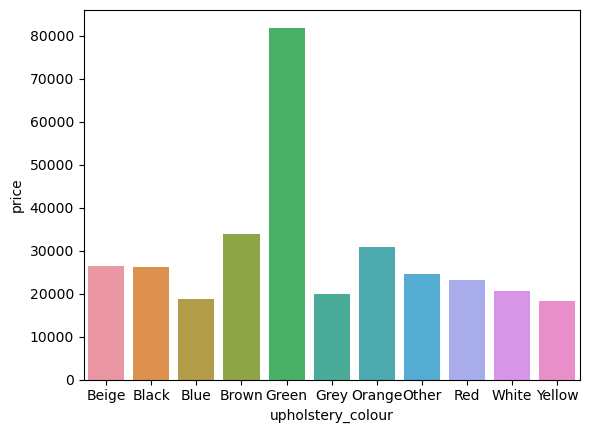

In [199]:
sns.barplot(x = df.groupby("upholstery_colour").price.mean().index, y = df.groupby("upholstery_colour").price.mean())

In [200]:
df.upholstery_colour.fillna('n_n',inplace=True)

In [201]:
df.groupby(['make','body_type','colour','upholstery_colour']).price.describe()

count           mean  \
make   body_type          colour upholstery_colour                         
Dacia   Compact           Beige  n_n                  1.0    7000.000000   
                          Black  Black                1.0    9390.000000   
                                 Grey                 4.0   14887.500000   
                                 n_n                 15.0   12230.733333   
                          Blue   Black                5.0   12608.000000   
                                 Grey                 2.0   11537.500000   
                                 Other                1.0   11990.000000   
                                 n_n                 23.0   11812.217391   
                          Bronze Black                1.0   10689.000000   
                          Brown  Black                1.0   11990.000000   
                                 n_n                  4.0   10881.000000   
                          Grey   Black                7.0   12721.428571   
                                 Grey                 3.0   17433.333333   
                                 n_n                 18.0   11750.055556   
                          Orange Black                2.0   16270.000000   
                                 Grey                 1.0   14780.000000   
                                 n_n                  2.0   16144.500000   
                          Red    Black                2.0    4917.500000   
                                 Grey                 2.0   15575.000000   
                                 n_n                 11.0   11095.363636   
                          Silver Black                2.0   16535.000000   
                                 Grey                15.0   22999.000000   
                                 n_n                  5.0   11120.800000   
                          Violet n_n                  3.0    8293.333333   
                          White  Black                8.0   17102.375000   
                                 Grey                11.0   21025.909091   
                                 n_n                 91.0   10839.307692   
                          Yellow n_n                  2.0   15144.500000   
        Convertible       Black  n_n                  1.0   12900.000000   
                          White  n_n                  1.0   16900.000000   
        Coupe             White  n_n                  2.0   11400.000000   
        Off-Road/Pick-up  Beige  Black                3.0   14960.000000   
                                 n_n                  4.0   15267.500000   
                          Black  Black               39.0   16490.769231   
                                 Grey                 3.0   16900.666667   
                                 Other                1.0   16988.000000   
                                 n_n                 85.0   17261.576471   
                          Blue   Black               15.0   19185.066667   
                                 Grey                 2.0   14445.000000   
                                 Other                4.0   15791.750000   
                                 n_n                 20.0   15429.350000   
                          Brown  Black                3.0   11796.666667   
                                 n_n                  4.0   16070.000000   
                          Grey   Black               20.0   17756.500000   
                                 Grey                 6.0   16913.333333   
                                 Other                2.0   18494.000000   
                                 n_n                 25.0   17024.200000   
                          Orange Black               13.0   19452.000000   
                                 Grey                 2.0   18219.500000   
                                 Other                2.0   22333.500000   
                                 n_n                  5.0   17624.800000   
                        

In [202]:
df.upholstery_colour.replace('n_n',np.nan,inplace=True)

In [203]:
fill_bymode_triple(df,"make","body_type",'colour','upholstery_colour')

In [204]:
df.upholstery_colour.isna().sum()

0

<Axes: xlabel='upholstery_colour', ylabel='price'>

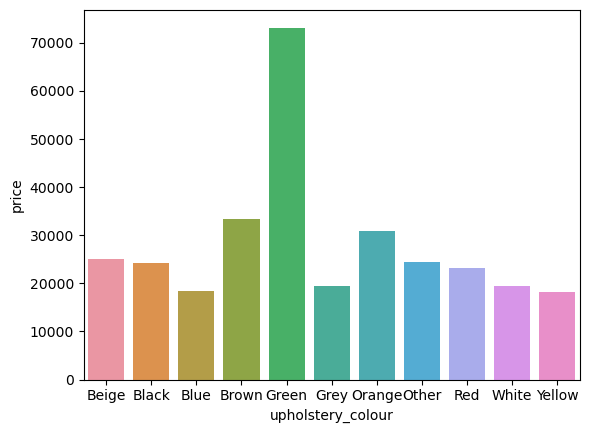

In [205]:
sns.barplot(x = df.groupby("upholstery_colour").price.mean().index, y = df.groupby("upholstery_colour").price.mean())

In [206]:
df.upholstery_colour.value_counts()

Black     20412
Grey       2147
Other       947
Beige       438
Brown       252
Red         152
White        87
Blue         81
Orange       21
Green         9
Yellow        6
Name: upholstery_colour, dtype: int64

### previous_owner

In [207]:
first_looking('previous_owner')

column name    :  previous_owner
--------------------------------
per_of_nulls   :  % 47.34
num_of_nulls   :  11623
num_of_uniques :  14
--------------------------------
NaN     11623
1.0      8991
2.0      2991
3.0       641
4.0       166
5.0        62
6.0        28
7.0        20
8.0        14
9.0        10
10.0        2
12.0        2
14.0        1
13.0        1
Name: previous_owner, dtype: int64


<Axes: xlabel='previous_owner', ylabel='price'>

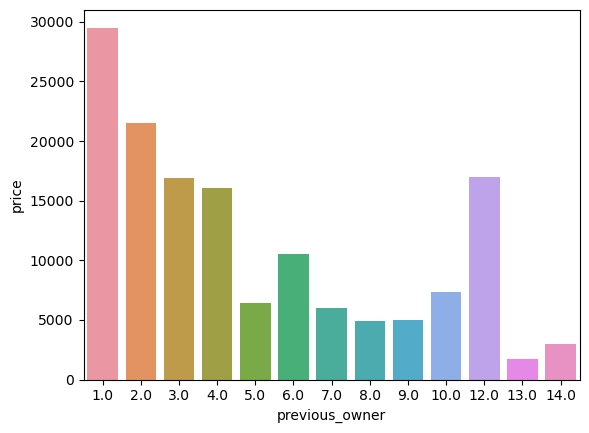

In [208]:
sns.barplot(x = df.groupby("previous_owner").price.mean().index, y = df.groupby("previous_owner").price.mean())

In [209]:
df.previous_owner.fillna('n_n',inplace=True)

In [210]:
df.groupby(['make','age','mileage','previous_owner']).price.describe()

count           mean          std  \
make  age  mileage  previous_owner                                      
Dacia 0.0  0.0      n_n               2.0   17995.000000  2128.391411   
           1.0      n_n               3.0   19073.333333  4597.133165   
           4.0      n_n               4.0   16474.000000   505.799697   
           5.0      1.0               1.0   20610.000000          NaN   
                    2.0               1.0   23950.000000          NaN   
           6.0      n_n               2.0   21794.500000  3966.161936   
           7.0      n_n               4.0   19490.000000  2915.475947   
           8.0      1.0               1.0   22140.000000          NaN   
                    n_n               4.0   17282.500000   713.366432   
           9.0      n_n              10.0   17790.000000  1085.254706   
           10.0     1.0              13.0   20123.615385  4529.385068   
                    n_n              23.0   20056.521739  3317.362875   
           11.0     1.0               1.0   21989.000000          NaN   
                    n_n               6.0   18323.333333  1032.795559   
           12.0     1.0               3.0   18009.666667  2686.244653   
                    n_n               6.0   18990.000000     0.000000   
           13.0     1.0               1.0   22678.000000          NaN   
                    n_n               2.0   17940.000000  1343.502884   
           15.0     n_n               6.0   18323.333333  1402.378931   
           17.0     n_n               1.0   17490.000000          NaN   
           18.0     1.0               1.0   22299.000000          NaN   
                    n_n               1.0   17490.000000          NaN   
           20.0     1.0               8.0   19273.750000  2429.420492   
                    n_n               1.0   17900.000000          NaN   
           25.0     n_n               1.0   17590.000000          NaN   
           29.0     n_n               1.0   16490.000000          NaN   
           31.0     1.0               1.0   17890.000000          NaN   
           41.0     n_n               1.0   17490.000000          NaN   
           50.0     1.0               9.0   24529.777778  1869.480595   
           81.0     1.0               1.0   24900.000000          NaN   
           90.0     n_n               1.0   16900.000000          NaN   
           100.0    1.0               4.0   23960.000000  1678.908376   
           110.0    1.0               4.0   24213.750000  2288.308746   
           150.0    1.0               3.0   21209.666667  5178.321189   
           181.0    n_n               1.0   17490.000000          NaN   
           182.0    n_n               1.0   17490.000000          NaN   
           200.0    n_n               1.0   24490.000000          NaN   
           220.0    1.0               1.0   21990.000000          NaN   
           308.0    n_n               1.0   14100.000000          NaN   
           400.0    n_n               1.0   24900.000000          NaN   
           500.0    1.0               1.0   23400.000000          NaN   
                    n_n               4.0   21603.000000     4.618802   
           550.0    1.0               1.0   17450.000000          NaN   
           800.0    1.0               2.0   24900.000000     0.000000   
           910.0    1.0               1.0   21590.000000          NaN   
           999.0    n_n               1.0   20500.000000          NaN   
           1000.0   n_n               1.0   21000.000000          NaN   
           1001.0   1.0               1.0   14080.000000          NaN   
           1200.0   1.0               1.0   18540.000000          NaN   
           1234.0   1.0               1.0   21390.000000          NaN   
           1252.0   n_n               1.0   29950.000000          NaN   
           1360.0   1.0               1.0   23200.000000          NaN   
           1500.0   1.0               1.0   24949.000000          NaN   
           1759.0   1

In [211]:
#fill_bymode_triple(df,'make','age','mileage','previous_owner')
#takes too much time- use two layer fillna

In [212]:
df.groupby(['make','age','previous_owner']).price.describe()

count           mean            std       min  \
make    age    previous_owner                                                  
Dacia    0.0   1.0              87.0   21000.034483    3678.360009   12010.0   
               2.0               1.0   23950.000000            NaN   23950.0   
               n_n             110.0   19051.663636    2966.851868   14000.0   
         1.0   1.0              64.0   20499.015625    3418.505830   10990.0   
               n_n              40.0   17759.225000    3109.766571   10690.0   
         2.0   1.0              23.0   15186.434783    3076.512707    9950.0   
               2.0               4.0   15569.500000    2434.973032   12400.0   
               n_n              52.0   15414.384615    2864.609272   10490.0   
         3.0   1.0              46.0   14593.000000    3102.223955    9490.0   
               2.0               7.0   13486.428571    3997.504132    8490.0   
               n_n             117.0   13758.914530    3030.817062    5950.0   
         4.0   1.0              44.0   13089.454545    2287.207513    6949.0   
               2.0               3.0   12960.000000     814.063880   12490.0   
               n_n             121.0   13033.710744    2769.971617    6800.0   
         5.0   1.0              35.0   11674.171429    3262.007939    7000.0   
               2.0               8.0   11139.125000    1745.869119    6999.0   
               n_n              87.0   12093.482759    2611.949610    6900.0   
         6.0   1.0              13.0    9743.461538    1726.508259    6600.0   
               2.0               5.0    8776.000000    1809.994475    6890.0   
               3.0               1.0    9890.000000            NaN    9890.0   
               n_n              57.0   10808.228070    2057.592404    6900.0   
         7.0   1.0              13.0    8658.461538    2211.586332    3890.0   
               2.0               2.0    6744.500000    1054.296211    5999.0   
               n_n              36.0    9663.388889    2492.077587    5390.0   
         8.0   1.0              10.0    8031.700000    2870.970686    4790.0   
               2.0               2.0    9570.000000    1951.614716    8190.0   
               n_n              26.0    8652.423077    2404.539244    4499.0   
         9.0   1.0               8.0    7419.625000    1951.311715    4999.0   
               2.0               7.0    6255.571429    1120.259175    4999.0   
               n_n              14.0    7319.928571    2090.330135    2300.0   
         10.0  1.0               8.0    6566.250000    1079.668435    5490.0   
               2.0               4.0    5192.250000    1827.608706    2999.0   
               n_n              16.0    7192.000000    1970.370591    2999.0   
         11.0  1.0               6.0    6186.666667     926.707433    4800.0   
               2.0               2.0    6822.500000     173.241161    6700.0   
               n_n               7.0    6971.428571    2185.462793    4950.0   
         12.0  1.0               3.0    3649.666667    1126.121811    2999.0   
               2.0               2.0    3925.000000    1732.411614    2700.0   
               n_n              12.0    5637.500000    1706.688047    1490.0   
         13.0  1.0               3.0    4633.000000     549.060106    3999.0   
               2.0               2.0    3197.500000    1127.835316    2400.0   
               n_n               6.0    3753.333333    1325.306254    2400.0   
         14.0  1.0               2.0    3494.500000    2127.684305    1990.0   
               3.0               1.0    2900.000000            NaN    2900.0   
               n_n               6.0    3478.333333    1885.602468    1700.0   
         15.0  1.0               3.0    1949.333333     507.001315    1500.0   
               n_n               1.0    1650.000000            NaN    1650.0   
         47.0  n_n               1.0    9999.000000            NaN    9999.0   
Fiat    -3.0   n_n             

In [213]:
df.groupby(['make','mileage','previous_owner']).price.describe()

count           mean           std       min  \
make  mileage  previous_owner                                                 
Dacia 0.0      n_n               2.0   17995.000000   2128.391411   16490.0   
      1.0      n_n               6.0   19645.000000   2994.319622   14850.0   
      4.0      n_n               4.0   16474.000000    505.799697   15899.0   
      5.0      1.0               2.0   20455.000000    219.203102   20300.0   
               2.0               1.0   23950.000000           NaN   23950.0   
      6.0      n_n               2.0   21794.500000   3966.161936   18990.0   
      7.0      1.0               1.0   20300.000000           NaN   20300.0   
               n_n               4.0   19490.000000   2915.475947   16490.0   
      8.0      1.0               1.0   22140.000000           NaN   22140.0   
               n_n               4.0   17282.500000    713.366432   16490.0   
      9.0      n_n              10.0   17790.000000   1085.254706   16490.0   
      10.0     1.0              20.0   19441.850000   3942.191953   12010.0   
               n_n              26.0   20325.000000   3273.209129   16450.0   
      11.0     1.0               1.0   21989.000000           NaN   21989.0   
               n_n               6.0   18323.333333   1032.795559   16990.0   
      12.0     1.0               3.0   18009.666667   2686.244653   15440.0   
               n_n               6.0   18990.000000      0.000000   18990.0   
      13.0     1.0               1.0   22678.000000           NaN   22678.0   
               n_n               3.0   18393.000000   1232.122965   16990.0   
      15.0     n_n               6.0   18323.333333   1402.378931   15990.0   
      17.0     n_n               1.0   17490.000000           NaN   17490.0   
      18.0     1.0               1.0   22299.000000           NaN   22299.0   
               n_n               1.0   17490.000000           NaN   17490.0   
      20.0     1.0               9.0   18986.666667   2430.241758   16690.0   
               n_n               1.0   17900.000000           NaN   17900.0   
      25.0     n_n               1.0   17590.000000           NaN   17590.0   
      29.0     n_n               1.0   16490.000000           NaN   16490.0   
      30.0     1.0               1.0   20150.000000           NaN   20150.0   
      31.0     1.0               1.0   17890.000000           NaN   17890.0   
      40.0     1.0               1.0   17000.000000           NaN   17000.0   
      41.0     n_n               1.0   17490.000000           NaN   17490.0   
      50.0     1.0              10.0   24385.800000   1820.418926   21750.0   
      81.0     1.0               1.0   24900.000000           NaN   24900.0   
      90.0     n_n               1.0   16900.000000           NaN   16900.0   
      100.0    1.0               4.0   23960.000000   1678.908376   21450.0   
      110.0    1.0               4.0   24213.750000   2288.308746   22299.0   
      150.0    1.0               3.0   21209.666667   5178.321189   15240.0   
      181.0    n_n               1.0   17490.000000           NaN   17490.0   
      182.0    n_n               1.0   17490.000000           NaN   17490.0   
      200.0    n_n               1.0   24490.000000           NaN   24490.0   
      220.0    1.0               1.0   21990.000000           NaN   21990.0   
      308.0    n_n               1.0   14100.000000           NaN   14100.0   
      400.0    1.0               1.0   27960.000000           NaN   27960.0   
               n_n               1.0   24900.000000           NaN   24900.0   
      500.0    1.0               1.0   23400.000000           NaN   23400.0   
               n_n               4.0   21603.000000      4.618802   21599.0   
      550.0    1.0               1.0   17450.000000           NaN   17450.0   
      800.0    1.0               2.0   24900.000000      0.000000   24900.0   
      909.0    n_n               1.0   14900.000000           NaN   14900.0   
  

In [214]:
df.previous_owner.replace('n_n',np.nan, inplace=True)

In [215]:
fill_bymode_double(df, 'make','age','previous_owner')

<Axes: xlabel='previous_owner', ylabel='price'>

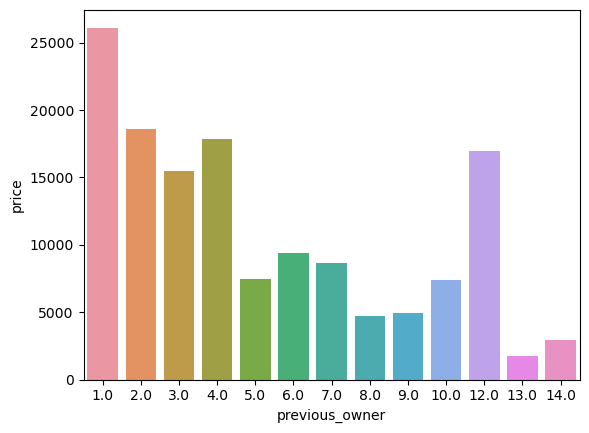

In [216]:
sns.barplot(x = df.groupby("previous_owner").price.mean().index, y = df.groupby("previous_owner").price.mean())

In [217]:
df.previous_owner.isna().sum()

0

### fuel_comb_cons

In [218]:
first_looking('fuel_comb_cons')

column name    :  fuel_comb_cons
--------------------------------
per_of_nulls   :  % 19.44
num_of_nulls   :  4772
num_of_uniques :  162
--------------------------------
NaN     4772
4.9      709
5.0      651
0.0      577
4.7      576
5.1      555
4.8      554
4.5      534
5.4      534
5.3      508
5.2      508
4.3      493
4.2      480
4.6      472
5.6      453
5.5      449
4.1      438
5.9      432
5.7      428
4.4      373
6.4      370
6.0      370
4.0      369
3.8      365
5.8      358
6.3      315
3.9      302
3.7      275
6.5      272
7.0      266
3.6      256
6.1      249
6.2      245
6.6      237
6.9      227
6.7      225
7.4      222
7.1      207
6.8      206
7.2      192
8.4      184
7.3      183
8.0      181
7.6      164
8.2      161
7.8      157
3.5      153
7.7      152
7.5      150
3.4      114
9.2       96
3.3       94
12.0      94
8.6       86
8.3       83
7.9       80
9.8       72
1.5       72
9.0       72
8.7       71
12.5      69
8.8       68
9.5       66
8.9       6

<Axes: xlabel='fuel_comb_cons', ylabel='price'>

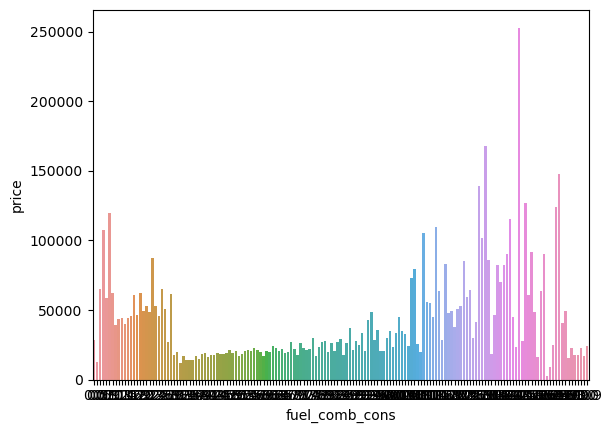

In [219]:
sns.barplot(x = df.groupby("fuel_comb_cons").price.mean().index, y = df.groupby("fuel_comb_cons").price.mean())

In [220]:
# df[df.engine_size == 0]
# df[(df.fuel_type == 'electric') & (df.engine_size == 0)]

In [221]:
cond_elct = (df.fuel_type == 'electric') & (df.engine_size == 0)

If engine size 0 and engine is electric fill null by mean 

In [222]:
df.loc[cond_elct, 'fuel_comb_cons'] = df.loc[cond_elct, 'fuel_comb_cons'].fillna(df[df.fuel_type == 'electric'].fuel_comb_cons.mean())

In [223]:
df.loc[cond_elct, 'fuel_city_cons'] = df.loc[cond_elct, 'fuel_city_cons'].fillna(df[df.fuel_type == 'electric'].fuel_city_cons.mean())

In [224]:
df.loc[cond_elct, 'fuel_country_cons'] = df.loc[cond_elct, 'fuel_country_cons'].fillna(df[df.fuel_type == 'electric'].fuel_country_cons.mean())

In [225]:
df.fuel_comb_cons.fillna('n_n',inplace=True)

In [226]:
df.groupby(["make","body_type",'engine_size','fuel_comb_cons']).price.describe()

count           mean  \
make  body_type          engine_size fuel_comb_cons                             
Dacia  Compact           0.0         1.5468354430379747    1.0   19515.000000   
                         898.0       4.9                   6.0   10975.833333   
                                     5.0                   1.0   13499.000000   
                                     5.1                  27.0   12508.888889   
                                     5.2                  16.0   10425.312500   
                                     5.3                   1.0   12490.000000   
                                     5.5                   2.0   12440.000000   
                                     5.6                  12.0   12531.333333   
                                     6.2                   1.0   11950.000000   
                                     7.0                   1.0   14950.000000   
                                     n_n                  31.0   21893.774194   
                         899.0       4.9                   1.0   11990.000000   
                         998.0       5.0                   1.0   10689.000000   
                                     n_n                   2.0   10499.000000   
                         999.0       0.0                   3.0   13108.333333   
                                     4.5                   1.0   15240.000000   
                                     4.6                   2.0   14301.500000   
                                     4.8                   1.0   14080.000000   
                                     4.9                  10.0   14765.700000   
                                     5.0                   6.0   14714.833333   
                                     5.1                   8.0   14927.500000   
                                     5.2                  14.0   15415.642857   
                                     5.3                  13.0   11416.153846   
                                     5.6                   1.0   16690.000000   
                         1149.0      5.8                  19.0    7827.263158   
                                     5.9                   7.0    6431.428571   
                         1390.0      6.8                   1.0    2400.000000   
                                     7.0                   1.0    2945.000000   
                         1461.0      3.5                  10.0   10293.000000   
                                     3.6                   2.0   11935.000000   
                                     3.8                  26.0   11410.230769   
                                     4.0                   4.0   10692.500000   
                                     4.1                   1.0    6900.000000   
                                     4.2                   1.0   11930.000000   
                                     4.5                   2.0    5790.000000   
                                     5.0                   2.0    8099.000000   
                                     n_n                   2.0   13499.500000   
                         1598.0      7.3                   2.0    6795.000000   
                                     7.6                   1.0    7700.000000   
       Convertible       898.0       0.0                   1.0   12900.000000   
                         1598.0      0.0                   1.0   16900.000000   
       Coupe             898.0       5.1                   1.0   12900.000000   
                         1149.0      n_n                   1.0    9900.000000   
       Off-Road/Pick-up  332.0       n_n                   1.0   21980.000000   
                         898.0       4.9                   1.0   11900.000000   
                                     5.0                   1.0   11899.000000   
                                     5.1                   1.0   14990.000000   
                                     5.3                   1.0   16950.000000   
       

#### Create mean fuction by layering

In [227]:
def fill_bymean_doublelayer(df, group_col1, group_col2, col_name):
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            cond1 = df[group_col1]==group1
            cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
            df.loc[cond2, col_name] = df.loc[cond2, col_name].fillna(df[cond2][col_name].mean()).fillna(df[cond1][col_name].mean())

In [228]:
def fill_bymean_triplelayer(df, group_col1, group_col2, group_col3, col_name):
    for group1 in list(df[group_col1].unique()):
        for group2 in list(df[group_col2].unique()):
            for group3 in list(df[group_col3].unique()):
                cond1 = df[group_col1]==group1
                cond2 = (df[group_col1]==group1) & (df[group_col2]==group2)
                cond3 = (df[group_col1]==group1) & (df[group_col2]==group2) & (df[group_col3]==group3)
                df.loc[cond3, col_name] = df.loc[cond3, col_name].fillna(df[cond3][col_name].mean()).fillna(df[cond2][col_name].mean()).fillna(df[cond1][col_name].mean())

In [229]:
df.fuel_comb_cons.replace('n_n',np.nan, inplace=True)

In [230]:
fill_bymean_triplelayer(df, "make","body_type",'engine_size','fuel_comb_cons')

In [231]:
df.fuel_comb_cons.isna().sum()

0

<Axes: xlabel='fuel_comb_cons', ylabel='price'>

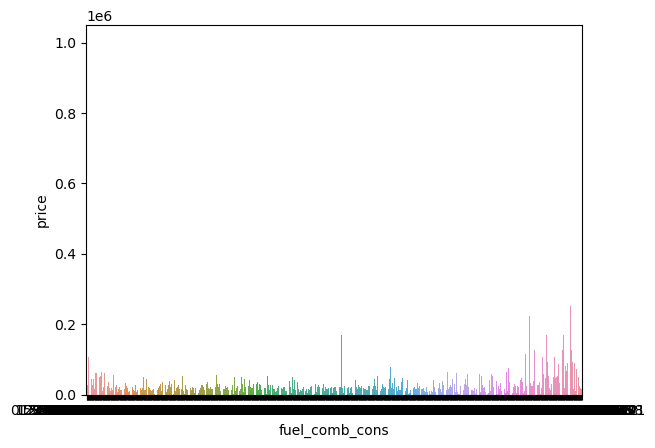

In [232]:
sns.barplot(x = df.groupby("fuel_comb_cons").price.mean().index, y = df.groupby("fuel_comb_cons").price.mean())

### fuel_city_cons 

In [233]:
first_looking('fuel_city_cons')

column name    :  fuel_city_cons
--------------------------------
per_of_nulls   :  % 30.7
num_of_nulls   :  7538
num_of_uniques :  197
--------------------------------
NaN        7538
5.7000      408
5.8000      407
6.4000      388
5.9000      379
5.3000      378
6.3000      373
6.0000      369
5.5000      366
6.6000      364
6.1000      363
6.2000      351
6.5000      348
0.0000      332
5.6000      298
5.2000      286
5.4000      284
6.8000      280
5.0000      261
5.1000      257
6.7000      255
7.0000      247
7.6000      230
4.3000      229
4.4000      224
4.7000      220
7.1000      219
4.2000      217
4.9000      210
7.9000      205
7.8000      199
4.6000      197
7.2000      193
6.9000      193
7.3000      192
8.5000      184
8.2000      182
4.5000      180
8.9000      180
7.4000      179
8.0000      174
9.3000      174
7.5000      173
9.1000      171
4.8000      170
8.1000      165
8.6000      164
7.7000      157
8.7000      145
10.1000     141
8.8000      139
9.0000      131

<Axes: xlabel='fuel_city_cons', ylabel='price'>

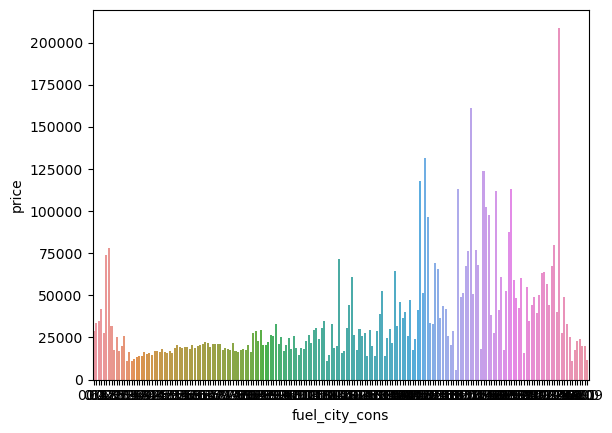

In [234]:
sns.barplot(x = df.groupby("fuel_city_cons").price.mean().index, y = df.groupby("fuel_city_cons").price.mean())

In [235]:
df.fuel_city_cons.fillna('n_n',inplace=True)

In [236]:
df.groupby(["make","body_type",'power',"fuel_city_cons"]).price.describe()

count           mean  \
make  body_type          power fuel_city_cons                         
Dacia  Compact           33.0  0.6875            1.0   19515.000000   
                               n_n              29.0   22728.517241   
                         49.0  6.0               4.0   13552.500000   
                               n_n               1.0   14100.000000   
                         50.0  5.0               2.0    5790.000000   
                         54.0  5.9               1.0   10900.000000   
                               6.0               1.0    9500.000000   
                               6.1               1.0   10689.000000   
                               6.5               1.0   10234.000000   
                               n_n               3.0    9996.000000   
                         55.0  3.7               4.0    9995.000000   
                               4.3               5.0    8900.000000   
                               5.0               1.0    6900.000000   
                               6.5               2.0   11588.500000   
                               6.8              10.0   10538.000000   
                               7.6              26.0    7451.461538   
                               9.3               1.0    2400.000000   
                               9.6               1.0    2945.000000   
                         56.0  n_n               1.0   10499.000000   
                         62.0  9.8               2.0    6795.000000   
                         64.0  10.2              1.0    7700.000000   
                         65.0  5.9               2.0    8099.000000   
                         66.0  3.7               3.0    9916.666667   
                               3.8               6.0   11835.666667   
                               4.3               6.0    9429.000000   
                               4.4               1.0   11930.000000   
                               4.6               4.0   10692.500000   
                               5.7               6.0   11737.500000   
                               5.8              26.0   12187.692308   
                               6.0               2.0   17690.000000   
                               6.5               2.0   11690.000000   
                               6.7              28.0   11327.892857   
                               7.6               1.0   11950.000000   
                               n_n               5.0   12463.800000   
                         67.0  0.0               3.0   13108.333333   
                               4.3               1.0   17000.000000   
                               5.7               1.0   15080.000000   
                               5.9               7.0   16109.285714   
                               6.0               3.0   19353.333333   
                               6.1               1.0   19140.000000   
                               6.2               1.0   14080.000000   
                               6.3               1.0   14130.000000   
                               6.6               1.0   16690.000000   
                               6.7               1.0   15240.000000   
                         68.0  6.1               1.0   15850.000000   
                         70.0  3.7               3.0   11066.666667   
                               3.8              10.0   13756.800000   
                               4.1               1.0   10880.000000   
                         74.0  5.8               5.0   13116.800000   
                               6.2               1.0   14990.000000   
                               6.3               5.0   16873.600000   
                               6.5               5.0   14228.000000   
                               7.9               1.0   16200.000000   
                         85.0  n_n               1.0   16500.000000   
       Convertible       66.0  n_n               1.0   12900.000000   


In [237]:
df.fuel_city_cons.replace('n_n',np.nan, inplace=True)

In [238]:
fill_bymode_triple(df,"make","body_type",'power',"fuel_city_cons")

In [239]:
df.fuel_city_cons.isna().sum()

0

<Axes: xlabel='fuel_city_cons', ylabel='price'>

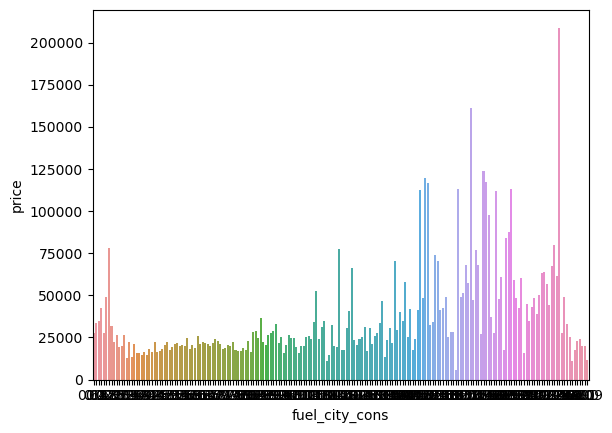

In [240]:
sns.barplot(x = df.groupby("fuel_city_cons").price.mean().index, y = df.groupby("fuel_city_cons").price.mean())

### fuel_country_cons 

In [241]:
first_looking('fuel_country_cons')

column name    :  fuel_country_cons
--------------------------------
per_of_nulls   :  % 30.92
num_of_nulls   :  7591
num_of_uniques :  116
--------------------------------
NaN      7591
4.30      711
4.20      677
4.70      661
5.00      604
4.50      599
4.00      580
3.90      571
4.10      562
4.60      560
4.90      539
3.80      527
4.40      520
5.10      517
3.60      515
3.70      468
4.80      391
5.30      389
5.70      372
5.20      350
5.60      340
5.50      337
5.80      334
0.00      314
5.40      292
3.40      284
5.90      272
6.50      272
3.50      255
6.20      252
3.30      238
6.00      227
6.10      221
6.30      185
6.40      178
6.70      172
3.20      164
7.00      145
6.90      144
6.80      122
8.70      105
3.10      101
7.80      101
6.60      101
7.10       98
3.00       93
7.60       89
0.75       84
8.10       82
7.30       77
7.40       75
8.50       73
7.20       71
8.30       67
7.70       67
9.10       65
8.80       64
8.00       61
7.90       55
8

<Axes: xlabel='fuel_country_cons', ylabel='price'>

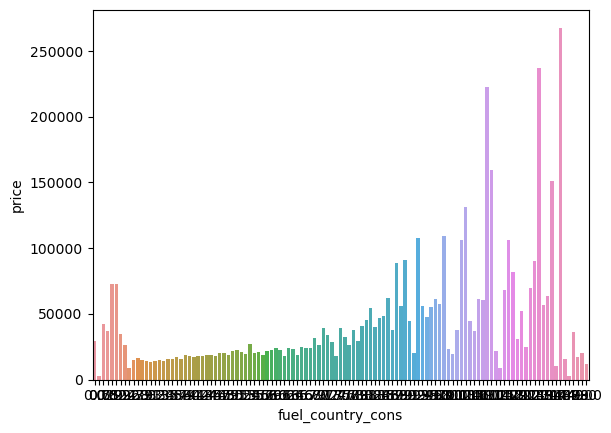

In [242]:
sns.barplot(x = df.groupby("fuel_country_cons").price.mean().index, y = df.groupby("fuel_country_cons").price.mean())

In [243]:
df.fuel_country_cons.fillna('n_n',inplace=True)

In [244]:
df.groupby(['make','body_type','power','fuel_country_cons']).price.describe()

count           mean  \
make  body_type          power fuel_country_cons                         
Dacia  Compact           33.0  0.75                 1.0   19515.000000   
                               n_n                 29.0   22728.517241   
                         49.0  4.3                  4.0   13552.500000   
                               n_n                  1.0   14100.000000   
                         50.0  4.3                  2.0    5790.000000   
                         54.0  4.3                  1.0   10689.000000   
                               4.5                  1.0   10234.000000   
                               4.7                  2.0   10200.000000   
                               n_n                  3.0    9996.000000   
                         55.0  3.4                  4.0    9995.000000   
                               3.5                  5.0    8900.000000   
                               3.7                 11.0   10207.272727   
                               4.5                  2.0   11588.500000   
                               4.9                 26.0    7451.461538   
                               5.3                  1.0    2400.000000   
                               5.4                  1.0    2945.000000   
                         56.0  n_n                  1.0   10499.000000   
                         62.0  6.2                  2.0    6795.000000   
                         64.0  6.1                  1.0    7700.000000   
                         65.0  4.6                  2.0    8099.000000   
                         66.0  3.4                  3.0    9916.666667   
                               3.5                  7.0    9937.714286   
                               3.7                  4.0   10692.500000   
                               3.8                  5.0   11604.800000   
                               4.1                  1.0   11930.000000   
                               4.3                 19.0   10562.368421   
                               4.4                  2.0   17690.000000   
                               4.5                  5.0   11291.000000   
                               4.7                 25.0   12378.400000   
                               4.9                  1.0   10890.000000   
                               5.0                 12.0   12531.333333   
                               5.4                  1.0   11950.000000   
                               n_n                  5.0   12463.800000   
                         67.0  0.0                  3.0   13108.333333   
                               4.1                  1.0   14080.000000   
                               4.3                  7.0   16493.714286   
                               4.4                  2.0   19144.500000   
                               4.6                  1.0   14130.000000   
                               4.7                  3.0   17636.666667   
                               4.8                  1.0   15080.000000   
                               4.9                  1.0   15240.000000   
                               6.1                  1.0   17000.000000   
                         68.0  4.4                  1.0   15850.000000   
                         70.0  3.4                  4.0   11020.000000   
                               3.8                 10.0   13756.800000   
                         74.0  4.0                  2.0   14301.500000   
                               4.1                  1.0   14990.000000   
                               4.3                  3.0   12327.000000   
                               4.4                  4.0   14322.500000   
                               4.6                  7.0   16345.428571   
                         85.0  n_n                  1.0   16500.000000   
       Convertible       66.0  n_n                  1.0   12900.000000   
                         84.0  n_n                  1.

In [245]:
df.fuel_country_cons.replace('n_n',np.nan, inplace=True)

In [246]:
fill_threelayer_for_and_backward(df,'make','body_type','power','fuel_country_cons')

In [247]:
df.fuel_country_cons.isna().sum()

0

<Axes: xlabel='fuel_country_cons', ylabel='price'>

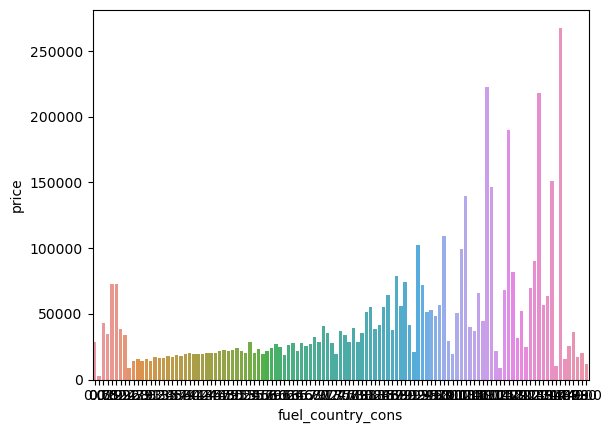

In [248]:
sns.barplot(x = df.groupby("fuel_country_cons").price.mean().index, y = df.groupby("fuel_country_cons").price.mean())

In [249]:
df.fuel_country_cons.shape

(24552,)

### comfort_convenience

In [250]:
first_looking("comfort_convenience")

column name    :  comfort_convenience
--------------------------------
per_of_nulls   :  % 9.96
num_of_nulls   :  2445
num_of_uniques :  14439
--------------------------------
NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   2445
Air conditioning, Automatic climate control, Cruise control                                                                                                                                                                  

In [251]:
#sns.barplot(x = df.groupby("comfort_convenience").price.mean().index, y = df.groupby("comfort_convenience").price.mean())
# needs too much ram

In [252]:
df.comfort_convenience.fillna('n_n',inplace=True)

In [253]:
df.groupby(["make","body_type",'age','comfort_convenience']).price.describe()

count  \
make  body_type          age  comfort_convenience                                         
Dacia  Compact           0.0  Air conditioning, Armrest, Automatic climate co...    1.0   
                              Air conditioning, Armrest, Automatic climate co...    1.0   
                              Air conditioning, Armrest, Automatic climate co...    2.0   
                              Air conditioning, Armrest, Automatic climate co...    1.0   
                              Air conditioning, Armrest, Cruise control, Elec...    1.0   
                              Air conditioning, Armrest, Cruise control, Hill...    2.0   
                              Air conditioning, Armrest, Cruise control, Hill...    1.0   
                              Air conditioning, Armrest, Cruise control, Hill...    1.0   
                              Air conditioning, Automatic climate control, Cr...    1.0   
                              Air conditioning, Automatic climate control, Cr...    2.0   
                              Air conditioning, Automatic climate control, Cr...    1.0   
                              Air conditioning, Cruise control, Electrical si...    1.0   
                              Air conditioning, Cruise control, Hill Holder, ...    1.0   
                              Air conditioning, Cruise control, Hill Holder, ...    1.0   
                              Air conditioning, Cruise control, Hill Holder, ...    1.0   
                              Air conditioning, Electrical side mirrors, Navi...    2.0   
                              Air conditioning, Multi-function steering wheel...    1.0   
                              n_n                                                   9.0   
                         1.0  Air conditioning, Armrest, Automatic climate co...    1.0   
                              Air conditioning, Armrest, Cruise control, Elec...    1.0   
                              Air conditioning, Cruise control, Hill Holder, ...    1.0   
                              Air conditioning, Cruise control, Hill Holder, ...    1.0   
                              Air conditioning, Electrical side mirrors, Hill...   25.0   
                              Air conditioning, Electrical side mirrors, Hill...    1.0   
                              Air conditioning, Electrical side mirrors, Hill...    1.0   
                              Air conditioning, Electrical side mirrors, Hill...    1.0   
                              Air conditioning, Power windows, Rain sensor          1.0   
                              Electrical side mirrors, Power windows, Start-s...    2.0   
                              Power windows, Start-stop system                      1.0   
                              n_n                                                   3.0   
                         2.0  Air conditioning                                      1.0   
                              Air conditioning, Armrest, Cruise control, Elec...    1.0   
                              Air conditioning, Automatic climate control, Mu...    1.0   
                              Air conditioning, Automatic climate control, Mu...    1.0   
                              Air conditioning, Automatic climate control, Mu...    1.0   
                              Air conditioning, Electrical side mirrors, Powe...    1.0   
                              Air conditioning, Hill Holder, Multi-function s...    1.0   
                              Air conditioning, Power windows, Start-stop system    1.0   
                              Electrical side mirrors, Power windows, Start-s...    1.0   
                              Power windows, Start-stop system                      3.0   
                              n_n                                                   3.0   
                         3.0  Air conditioning, Armrest, Cruise control, Elec...    1.0   
                              Air conditioning, Armrest, Hill Holder, Multi-f.

In [254]:
df.comfort_convenience.replace('n_n',np.nan,inplace=True)

In [255]:
fill_threelayer_for_and_backward(df,"make","body_type",'age','comfort_convenience')

In [256]:
df.comfort_convenience.isna().sum()

0

Too many categories, collect them together under some groups


#### Use wordcloud  library to analyse this

In [257]:
# pip install wordcloud
import wordcloud 

In [258]:
all_text_comfort = ",".join(df.comfort_convenience.to_list())
all_text_comfort

'Air conditioning, Electrical side mirrors, Power windows, Split rear seats,Air conditioning, Automatic climate control, Cruise control, Electrical side mirrors, Navigation system, Parking assist system sensors front, Parking assist system sensors rear, Rain sensor, Seat heating,Air conditioning, Automatic climate control, Power windows, Rain sensor,Air conditioning, Automatic climate control, Power windows, Rain sensor,Air conditioning, Electrical side mirrors, Multi-function steering wheel, Power windows, Split rear seats,Air conditioning, Armrest, Automatic climate control, Cruise control, Electrical side mirrors, Lumbar support, Multi-function steering wheel, Panorama roof, Parking assist system sensors front, Parking assist system sensors rear, Power windows, Rain sensor, Sunroof, Tinted windows,Air conditioning, Automatic climate control, Electrical side mirrors, Multi-function steering wheel, Power windows,Air conditioning, Automatic climate control, Power windows, Rain sensor,M

In [259]:
len(all_text_comfort)

6576036

In [260]:
type(all_text_comfort)

str

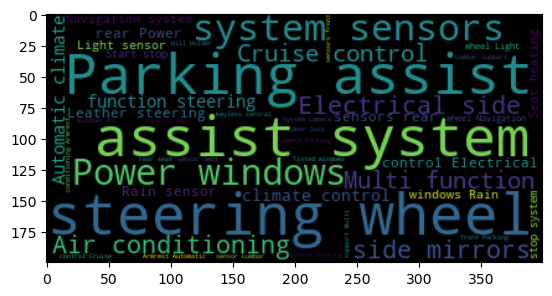

In [261]:
word_comfort = wordcloud.WordCloud().generate(all_text_comfort)
plt.imshow(word_comfort,interpolation='bilinear')
plt.show()

In [262]:
#check frequency
word_comfort.words_

{'steering wheel': 1.0,
 'Parking assist': 0.969506822247737,
 'assist system': 0.969506822247737,
 'system sensors': 0.6328802969213105,
 'Power windows': 0.575685562468292,
 'Air conditioning': 0.540813329417105,
 'Electrical side': 0.5245253798296441,
 'side mirrors': 0.5245253798296441,
 'Cruise control': 0.45998771728391763,
 'Multi function': 0.4538997623561454,
 'function steering': 0.4538997623561454,
 'Automatic climate': 0.4434594536861499,
 'climate control': 0.4434594536861499,
 'Leather steering': 0.426076740273958,
 'sensors rear': 0.3947024111505701,
 'Rain sensor': 0.3795092253878401,
 'rear Power': 0.37064430856318925,
 'control Electrical': 0.3693893353982537,
 'Light sensor': 0.35756054577981894,
 'windows Rain': 0.3517396064190542,
 'Navigation system': 0.3393500841099036,
 'Seat heating': 0.3280820271821847,
 'Start stop': 0.3253317668420069,
 'stop system': 0.3253317668420069,
 'wheel Navigation': 0.30904381725454594,
 'wheel Light': 0.305759525780353,
 'Armrest A

In [263]:
wordcloud.WordCloud().process_text(all_text_comfort)

{'Heads': 112,
 'display': 64,
 'Air conditioning': 20254,
 'conditioning Electrical': 1305,
 'Electrical side': 19644,
 'side mirrors': 19644,
 'mirrors Power': 1124,
 'Power windows': 21560,
 'windows Split': 1403,
 'Split rear': 6463,
 'seats Air': 893,
 'conditioning Automatic': 4823,
 'Automatic climate': 16608,
 'climate control': 16608,
 'control Cruise': 8704,
 'Cruise control': 17227,
 'control Electrical': 13834,
 'mirrors Navigation': 101,
 'Navigation system': 12709,
 'system Parking': 9410,
 'Parking assist': 36309,
 'assist system': 36309,
 'system sensors': 23702,
 'sensors front': 8920,
 'front Parking': 8836,
 'sensors rear': 14782,
 'rear Rain': 641,
 'Rain sensor': 14213,
 'sensor Seat': 9995,
 'Seat heating': 12287,
 'heating Air': 1436,
 'control Power': 349,
 'windows Rain': 13173,
 'sensor Air': 971,
 'mirrors Multi': 935,
 'Multi function': 16999,
 'function steering': 16999,
 'steering wheel': 37451,
 'wheel Power': 2935,
 'conditioning Armrest': 10855,
 'Armre

In [264]:
# # lower max_font_size, change the maximum number of word and lighten the background:
# wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(text)
# plt.figure()
# plt.imshow(wordcloud, interpolation="bilinear")
# plt.axis("off")
# plt.show()

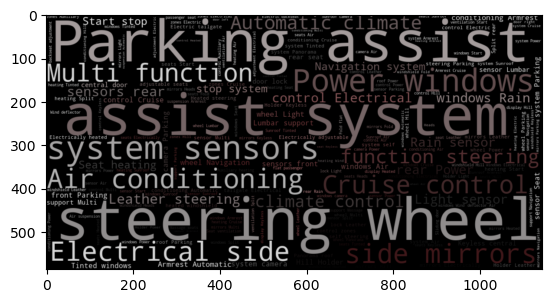

In [265]:
# Add a picture background to the word cloud

# import numpy as np
from PIL import Image
from wordcloud import WordCloud, ImageColorGenerator, STOPWORDS
# text = open('let it go.txt', 'r').read()
background_image = np.array(Image.open('/Users/pmzms1/Desktop/cars.png'))
img_colors = ImageColorGenerator(background_image)
wc = WordCloud(background_color = 'black', mask = background_image, width = 1920, height = 1080)
wc.generate_from_text(all_text_comfort)
wc.recolor(color_func = img_colors)
wc.to_file('cars_f.png')
plt.imshow(wc,interpolation='bilinear')
plt.show()

In [266]:
# copied from solution-did not have time to explore domain 

premium = ["Electrical side mirrors", "Parking assist", "Air conditioning", "Hill Holder", "Power windows"]
premium_plus = ["Multi-function", "Navigation ", "Keyless central door lock", "Heads-up", "Massage seats", "heating", "Automatic climate control", "Heated"]

df['comfort_convenience_Package'] = df['comfort_convenience'].apply(lambda sentence: "Premium Plus" if all(word in sentence for word in premium_plus) else ("Premium" if all(word in sentence for word in premium) else "Standard"))
df

,make,location,price,body_type,type,doors,warranty,mileage,gearbox,fuel_type,colour,seller,seats,power,engine_size,gears,co_emissions,drivetrain,cylinders,comfort_convenience,entertainment_media,safety_security,extras,empty_weight,full_service_history,emission_class,upholstery_colour,upholstery,previous_owner,age,fuel_comb_cons,fuel_city_cons,fuel_country_cons,comfort_convenience_Package
0,Mercedes-Benz,ES,16950.0,Compact,Used,5.0,24.0,120200.0,Manual,diesel,Black,Dealer,5.0,100.0,1991.0,6.0,104.0,Front,4.0,"Air conditioning, Electrical side mirrors, Pow...",NaN,NaN,NaN,1555.0,0,Euro 6,Black,Cloth,2.0,6.0,6.556566,4.9,4.4,Standard
1,Mercedes-Benz,ES,80900.0,Compact,Pre-registered,4.0,24.0,5000.0,Automatic,electric,Grey,Dealer,5.0,215.0,1.0,9.0,0.0,Front,4.0,"Air conditioning, Automatic climate control, C...",NaN,NaN,NaN,1555.0,1,Euro 6,Black,Cloth,1.0,0.0,5.480854,4.9,4.4,Standard
2,Mercedes-Benz,ES,69900.0,Compact,Used,5.0,12.0,18900.0,Automatic,benzine,Grey,Dealer,5.0,310.0,1991.0,8.0,126.0,4WD,4.0,"Air conditioning, Automatic climate control, P...",NaN,NaN,NaN,1555.0,1,Euro 6,Black,Cloth,1.0,2.0,8.400000,10.9,5.8,Standard
3,Mercedes-Benz,ES,46990.0,Compact,Used,5.0,12.0,18995.0,Automatic,benzine,Yellow,Dealer,5.0,225.0,1991.0,7.0,126.0,4WD,4.0,"Air conditioning, Automatic climate control, P...",USB,"ABS, Central door lock, Driver-side airbag, El...",Sport seats,1555.0,1,Euro 6,Black,Cloth,1.0,2.0,7.300000,9.3,6.1,Standard
4,Mercedes-Benz,ES,16800.0,Compact,Used,5.0,12.0,197000.0,Automatic,diesel,White,Dealer,5.0,100.0,2143.0,7.0,104.0,4WD,4.0,"Air conditioning, Electrical side mirrors, Mul...","Bluetooth, CD player, MP3, USB","ABS, Central door lock, Driver-side airbag, El...",NaN,1545.0,0,Euro 6,Black,Cloth,2.0,7.0,4.900000,5.7,4.4,Standard
5,Mercedes-Benz,DE,4690.0,Compact,Used,3.0,12.0,165000.0,Manual,benzine,Black,Dealer,4.0,90.0,1799.0,6.0,196.0,Rear,4.0,"Air conditioning, Armrest, Automatic climate c...","CD player, On-board computer, Radio","ABS, Bi-Xenon headlights, Central door lock, D...","Alloy wheels (17""), Catalytic Converter, Emerg...",1465.0,1,Euro 4,Black,Cloth,2.0,17.0,8.200000,11.6,6.2,Standard
6,Mercedes-Benz,ES,22550.0,Compact,Used,5.0,12.0,83339.0,Manual,diesel,Silver,Dealer,5.0,100.0,1991.0,6.0,104.0,Front,4.0,"Air conditioning, Automatic climate control, E...",NaN,NaN,NaN,1555.0,0,Euro 6,Black,Cloth,1.0,4.0,6.556566,4.9,4.4,Standard
7,Mercedes-Benz,ES,26900.0,Compact,Used,5.0,24.0,48900.0,Automatic,benzine,Grey,Dealer,5.0,140.0,1991.0,7.0,126.0,Front,4.0,"Air conditioning, Automatic climate control, P...",USB,"ABS, Central door lock, Driver-side airbag, El...",NaN,1450.0,1,Euro 6,Black,Cloth,1.0,3.0,6.100000,8.1,5.1,Standard
8,Mercedes-Benz,BE,44999.0,Compact,Used,5.0,12.0,56876.0,Automatic,benzine,Grey,Dealer,5.0,225.0,1991.0,7.0,168.0,Front,4.0,"Multi-function steering wheel, Navigation syst...",NaN,Emergency brake assistant,Sport package,1555.0,1,Euro 6,Black,Full leather,1.0,3.0,0.000000,9.3,6.1,Standard
9,Mercedes-Benz,ES,23900.0,Compact,Used,5.0,12.0,21854.0,Automatic,diesel,White,Dealer,5.0,102.0,1991.0,1.0,104.0,Front,4.0,"Air conditioning, Automatic climate control, E...",NaN,"ABS, Central door lock, Driver-side airbag, El...",Alloy wheels,1365.0,0,Euro 6,Black,Full leather,1.0,4.0,5.400000,6.9,4.5,Standard


In [267]:
df['comfort_convenience_Package'].shape

(24552,)

In [268]:
df['comfort_convenience'].shape

(24552,)

In [269]:
df['comfort_convenience_Package'].value_counts(dropna=False)

Standard        16360
Premium          8106
Premium Plus       86
Name: comfort_convenience_Package, dtype: int64

In [270]:
df.drop('comfort_convenience',axis=1,inplace=True)

### entertainment_media	

In [271]:
first_looking("entertainment_media")

column name    :  entertainment_media
--------------------------------
per_of_nulls   :  % 15.49
num_of_nulls   :  3803
num_of_uniques :  1945
--------------------------------
NaN                                                                                                                                                                                                                                               3803
CD player, On-board computer, Radio                                                                                                                                                                                                                530
On-board computer                                                                                                                                                                                                                                  527
Bluetooth, USB                                                                     

In [272]:
fill_threelayer_for_and_backward(df,"make","body_type",'age',"entertainment_media")

In [273]:
df.entertainment_media.isna().sum()

0

In [274]:
all_text_entertainment = ",".join(df.entertainment_media.to_list())

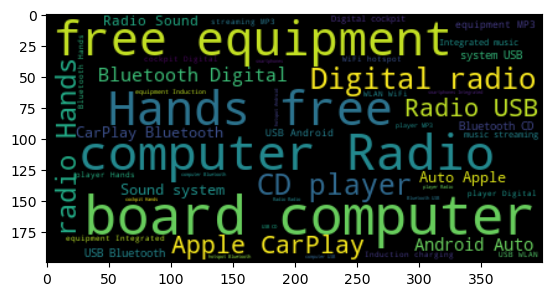

In [275]:
word_entertainment = wordcloud.WordCloud().generate(all_text_entertainment)
plt.imshow(word_entertainment,interpolation='bilinear')
plt.show()

In [276]:
wordcloud.WordCloud().process_text(all_text_entertainment)

{'smartphones': 697,
 'Bluetooth CD': 5472,
 'CD player': 8528,
 'player MP3': 1686,
 'MP3 USB': 221,
 'USB Bluetooth': 5617,
 'Bluetooth MP3': 303,
 'Radio USB': 7573,
 'USB USB': 76,
 'USB CD': 1087,
 'board computer': 18383,
 'computer Radio': 15273,
 'Bluetooth Digital': 7397,
 'Digital cockpit': 3707,
 'cockpit Hands': 618,
 'Hands free': 14093,
 'free equipment': 14093,
 'player Hands': 2563,
 'Sound system': 7084,
 'system USB': 5431,
 'player Radio': 673,
 'Radio Sound': 6226,
 'cockpit Digital': 2882,
 'Digital radio': 9376,
 'radio Hands': 8114,
 'equipment MP3': 4629,
 'Bluetooth Hands': 2452,
 'Bluetooth USB': 609,
 'USB Android': 4657,
 'Android Auto': 7378,
 'Auto Apple': 7195,
 'Apple CarPlay': 7629,
 'CarPlay Bluetooth': 7338,
 'equipment Induction': 1920,
 'Induction charging': 2140,
 'smartphones Integrated': 894,
 'Integrated music': 3501,
 'music streaming': 3501,
 'streaming MP3': 2112,
 'equipment Integrated': 2510,
 'USB WLAN': 2013,
 'WLAN WiFi': 2135,
 'WiFi ho

In [277]:
#copied from solution-did not have time to explore domain 

media_plus = ["Digital", "Television"]

df['entertainment_media_Package'] = df['entertainment_media'].apply(lambda sentence: "Premium Media" if any(word in sentence for word in media_plus) else "Standard Media")


In [278]:
df['entertainment_media_Package'].isna().sum()

0

In [279]:
df['entertainment_media_Package'].shape

(24552,)

In [280]:
df['entertainment_media_Package'].value_counts(dropna=False)

Standard Media    14298
Premium Media     10254
Name: entertainment_media_Package, dtype: int64

In [281]:
df.drop("entertainment_media",axis=1,inplace=True)

<Axes: xlabel='entertainment_media_Package', ylabel='price'>

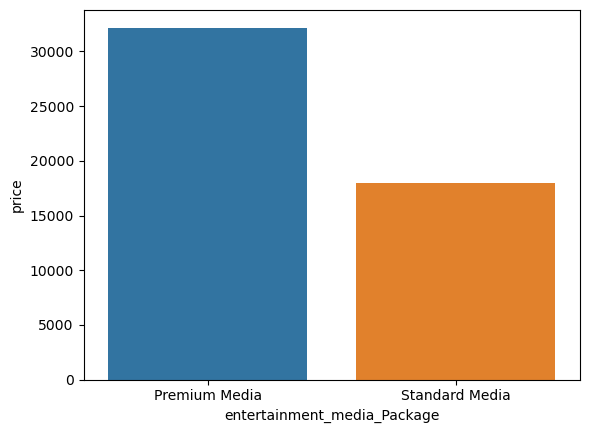

In [282]:
sns.barplot(x = df.groupby('entertainment_media_Package').price.mean().index, y = df.groupby('entertainment_media_Package').price.mean())

### extras 

In [283]:
first_looking("extras")

column name    :  extras
--------------------------------
per_of_nulls   :  % 16.56
num_of_nulls   :  4065
num_of_uniques :  9361
--------------------------------
NaN                                                                                                                                                                                                                                                                                                                    4065
Alloy wheels                                                                                                                                                                                                                                                                                                           2246
Alloy wheels, Sport seats                                                                                                                                                                                    

In [284]:
fill_threelayer_for_and_backward(df,"make","body_type",'age',"extras")

In [285]:
df.extras.isna().sum()

0

In [286]:
all_text_extras = ",".join(df.extras.to_list())

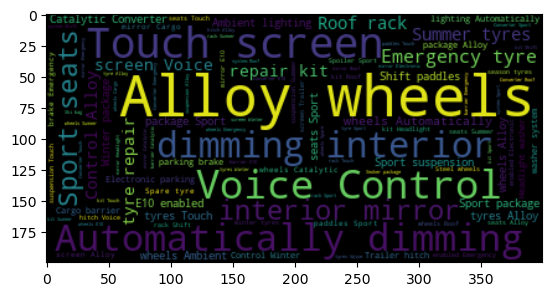

In [287]:
word_extras = wordcloud.WordCloud().generate(all_text_extras)
plt.imshow(word_extras,interpolation='bilinear')
plt.show()

In [288]:
wordcloud.WordCloud().process_text(all_text_extras)

{'Alloy wheels': 20849,
 'Sport seats': 7153,
 'seats Shift': 5,
 'Shift paddles': 3845,
 'paddles Sport': 1905,
 'seats Sport': 3158,
 'seats Alloy': 1103,
 'wheels Spoiler': 341,
 'Spoiler Alloy': 302,
 'wheels Catalytic': 2123,
 'Catalytic Converter': 3504,
 'Converter Emergency': 379,
 'Emergency tyre': 6849,
 'tyre repair': 5035,
 'repair kit': 5035,
 'kit Headlight': 938,
 'Headlight washer': 2612,
 'washer system': 2612,
 'system Smoker': 60,
 'Smoker package': 679,
 'package Sport': 3550,
 'Sport package': 3938,
 'package Alloy': 2782,
 'wheels Alloy': 3133,
 'Sport suspension': 3918,
 'suspension Alloy': 578,
 'wheels Automatically': 4697,
 'Automatically dimming': 7993,
 'dimming interior': 7993,
 'interior mirror': 7993,
 'mirror Spoiler': 230,
 'Spoiler Sport': 1338,
 'Voice Control': 8552,
 'Control Alloy': 4908,
 'mirror Cargo': 1957,
 'Cargo barrier': 2748,
 'barrier Emergency': 610,
 'Summer tyres': 5644,
 'tyres Winter': 584,
 'Winter package': 3389,
 'Ski bag': 719,
 

In [289]:
# copied from solution-did not have time to explore domain 

# prem_extra = ["Catalytic Converter", "Sport package", "Winter package", "wheels Automatically"]
# prem_plus_extra = ["suspension Summer", "Electronic parking", "brake Emergency", "enabled Emergency", "screen Trailer", "Spoiler Sport", "Winter tyres"]

prem_extra = ["Electronic parking"]
prem_plus_extra = ["Sport package"] 


In [290]:
df['extras'].apply(lambda sentence: "Premium Plus_extras" if all(word in sentence for word in prem_plus_extra) else ("Premium_extras" if all(word in sentence for word in prem_extra) else "Standard_extras")).value_counts(dropna=False)

Standard_extras        18564
Premium Plus_extras     3938
Premium_extras          2050
Name: extras, dtype: int64

In [291]:
df['extras_Package'] = df['extras'].apply(lambda sentence: "Premium Plus_extras" if all(word in sentence for word in prem_plus_extra) else ("Premium_extras" if all(word in sentence for word in prem_extra) else "Standard_extras"))

In [292]:
df['extras_Package'].shape

(24552,)

In [293]:
df['extras_Package'].value_counts()

Standard_extras        18564
Premium Plus_extras     3938
Premium_extras          2050
Name: extras_Package, dtype: int64

In [294]:
df.drop("extras",axis=1,inplace=True)

<Axes: xlabel='extras_Package', ylabel='price'>

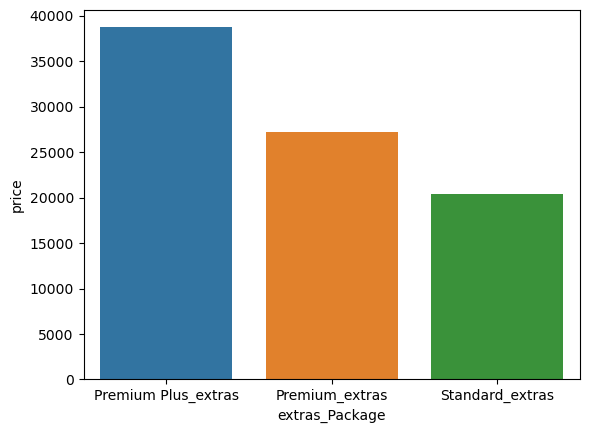

In [295]:
sns.barplot(x = df.groupby('extras_Package').price.mean().index, y = df.groupby('extras_Package').price.mean())

### safety_security

In [296]:
first_looking('safety_security')

column name    :  safety_security
--------------------------------
per_of_nulls   :  % 10.02
num_of_nulls   :  2459
num_of_uniques :  12550
--------------------------------
NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             2459
Isofix                                                                                                

In [297]:
fill_threelayer_for_and_backward(df,"make","body_type",'age',"safety_security")

In [298]:
df.safety_security.isna().sum()

0

In [299]:
all_text_security = ",".join(df.safety_security.to_list())

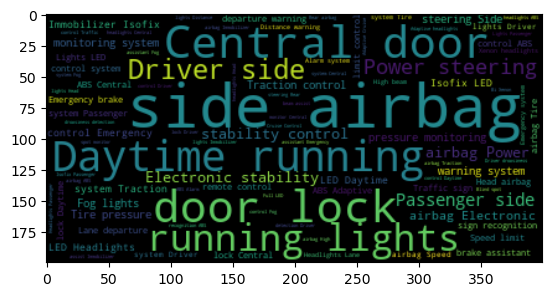

In [300]:
word_security = wordcloud.WordCloud().generate(all_text_security)
plt.imshow(word_security,interpolation='bilinear')
plt.show()

In [301]:
wordcloud.WordCloud().process_text(all_text_security)

{'ABS Central': 9282,
 'Central door': 27777,
 'door lock': 27777,
 'lock Driver': 3772,
 'Driver side': 21221,
 'side airbag': 61473,
 'airbag Isofix': 1025,
 'Isofix Adaptive': 3,
 'Adaptive headlights': 4588,
 'headlights Daytime': 88,
 'Daytime running': 23928,
 'running lights': 23928,
 'lights Driver': 6654,
 'airbag Emergency': 460,
 'Emergency system': 5906,
 'system LED': 47,
 'LED Daytime': 11727,
 'Lights LED': 7368,
 'LED Headlights': 11400,
 'Headlights Lane': 6018,
 'Lane departure': 8204,
 'departure warning': 8204,
 'warning system': 14624,
 'system Passenger': 7775,
 'Passenger side': 20428,
 'airbag Tire': 7556,
 'Tire pressure': 14407,
 'pressure monitoring': 14407,
 'monitoring system': 14407,
 'system ABS': 1846,
 'airbag Electronic': 17617,
 'Electronic stability': 18661,
 'stability control': 18661,
 'control Traction': 21,
 'Traction control': 14851,
 'control ABS': 7100,
 'control Isofix': 544,
 'Isofix Xenon': 38,
 'Xenon headlights': 6093,
 'headlights ABS': 

In [302]:
#copied from solution, did not have time to perform domain knowledge
premium = ["Tire pressure", "Daytime running lights", "LED Headlight"]
premium_plus = ["Traction control", "Emergency brake assistant", "Electronic stability control"]

df['safety_security_Package'] = df['safety_security'].apply(lambda sentence: "Safety Premium Package" if all(word in sentence for word in premium) else ("Safety Premium Plus Package" if all(word in sentence for word in premium_plus) else "Safety Standard Package"))

In [303]:
df['safety_security_Package'].value_counts(dropna=False)

Safety Standard Package        15003
Safety Premium Package          5947
Safety Premium Plus Package     3602
Name: safety_security_Package, dtype: int64

<Axes: xlabel='safety_security_Package', ylabel='price'>

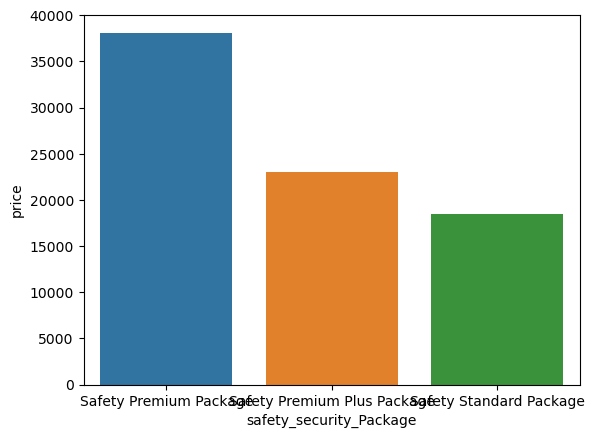

In [304]:
sns.barplot(x = df.groupby('safety_security_Package').price.mean().index, y = df.groupby('safety_security_Package').price.mean())

In [305]:
df.drop("safety_security",axis=1,inplace=True)

In [306]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24552 entries, 0 to 24551
Data columns (total 33 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   make                         24552 non-null  object 
 1   location                     24552 non-null  object 
 2   price                        24552 non-null  float64
 3   body_type                    24552 non-null  object 
 4   type                         24552 non-null  object 
 5   doors                        24552 non-null  float64
 6   warranty                     24552 non-null  float64
 7   mileage                      24552 non-null  float64
 8   gearbox                      24552 non-null  object 
 9   fuel_type                    24552 non-null  object 
 10  colour                       24552 non-null  object 
 11  seller                       24552 non-null  object 
 12  seats                        24552 non-null  float64
 13  power           

In [307]:
df.shape

(24552, 33)

In [308]:
null_sum = pd.DataFrame(df.isna().sum(), columns = ["null_sum"])
# null_sum
null_perc = round(pd.DataFrame(df.isna().sum()/df.shape[0]*100 , columns = ["null_perc"]),3)
# null_perc 

null_summary = pd.concat([null_sum,null_perc], axis= 1).reset_index().rename(columns = {"index":"col_names"})
null_summary

,col_names,null_sum,null_perc
0,make,0,0.0
1,location,0,0.0
2,price,0,0.0
3,body_type,0,0.0
4,type,0,0.0
5,doors,0,0.0
6,warranty,0,0.0
7,mileage,0,0.0
8,gearbox,0,0.0
9,fuel_type,0,0.0


### End of the section

## Export dataframe to csv file (without dummy)

In [309]:
df.to_csv("final_scout_not_dummy.csv", index=False)